<a href="https://colab.research.google.com/github/jean18/INF395-2021-1/blob/main/Tarea3/ANN_2021_1_Taller3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://www.inf.utfsm.cl/images/slides/Departamento-de-Informtica_HORIZONTAL.png" title="Title text" width="80%" />

<hr style="height:2px;border:none"/>
<h1 align='center'> INF-395/477 Redes Neuronales Artificiales I-2021 </h1>

<H3 align='center'> Tarea 3 - Redes Neuronales y Deep Learning </H3>
<hr style="height:2px;border:none"/>


## **Temas**  

* Redes Neuronales Recurrentes.
* Modelos Generativos.
* Autoencoders.
* Modelos Especiales.

****

## **Formalidades**  

* Equipos de trabajo de 3 personas.
* Formato de entrega: envı́o de Jupyter notebook y link de video Youtube o plataforma a convenir, todo esto vía Aula. 
* Cada persona debe estar en condiciones de realizar una presentación del trabajo realizado por su equipo y responder preguntas sobre el mismo. El día de la defensa oral serán seleccionados 4-5 presentadores aleatoriamente de entre la clase.
* La tarea tiene 2 partes: una pregunta de investigación donde se evalúa la metodología adoptada y un competencia donde pesa más el resultado y el ranking obtenido. 
* Fecha de Entrega de Código: Viernes 06 de Agosto de 2021 23:59:00 Hrs. (Se pueden cargar nuevas versiones hasta el Sábado 10 de Agosto 23:59:00 Hrs.).
* Fecha de Defensa Oral: Viernes 06 de Agosto de 2021 en horario de clases.
* Fecha de Entrega de Video: Sábado 7 de Agosto de 23:59:00 Hrs.

<hr style="height:2px;border:none"/>


## **Entregables**

* Se debe entregar el código utilizado en formato Jupyter/IPython notebook para poder **reproducir los resultados** presentados. El notebook debe estar ordenado para permitir identificar las celdas que a cada parte de la tarea y a las partes más importantes del desarrollo realizado. 

* Se debe preparar un video de **15 a 20 minutos** donde se explique cómo se abordó el taller. En el caso de la pregunta de investigación, se debe explicar muy bien (1) la metodología a utilizar (datasets considerados, pre-procesamiento de datos, arquitecturas a evaluar, parámetros a variar, parámetros a mantener constantes, métricas con las que se evaluará el resultado, etc.), (2) los resultados obtenidos y (3) las conclusiones de la experiencia. En el caso del desafío, se debe narrar brevemente la estrategia de solución adoptada enfocándose en aquello que los autores creen que la hará la solución ganadora. 



****


## **Pregunta de Investigación (60%)**


Refute o demuestre una de las siguientes hipótesis entregando evidencia experimental a favor o en contra: 

> **20. (Avanzado) Auto-encoders Variacionales**: A diferencia de una GAN, un VAE no experimenta el problema denominado *colapso modal*. 

### Librerias

In [ ]:
# Librerias
import IPython 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns; sns.set_theme()
from sklearn.decomposition import PCA
import tensorflow as tf
import tensorflow_probability as tfp
from tensorflow.keras.layers import Dense, Conv2D, Flatten, InputLayer, Reshape, Conv2DTranspose, BatchNormalization, UpSampling2D
from tensorflow.keras.models import Model, Sequential

tfd = tfp.distributions
tfpl = tfp.layers
tfb = tfp.bijectors

In [ ]:
print("Mounting your Google Drive ...")

from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive', force_remount=True)

# Esta es la ruta en mi drive
path = '/content/drive/MyDrive/Intro a las redes neuronales/Tareas/Tarea 3/'

Mounting your Google Drive ...
Mounted at /content/drive


### Prior


Usaremos un prior que es una mezcla de Gaussianas. Esta es una distribución más flexible, la cual se compone de $K$ Gaussianas independientes, las que se combinan asignando cierto peso a cada una.

Recordemos que la función de densidad de probabilidad de una Gaussiana multivariada con media $\mu\in\mathbb{R}^D$ y matriz de covarianza $\Sigma\in\mathbb{R}^{D\times D}$ corresponde a:

$$
\mathcal{N}(\mathbf{z}; \mathbf{\mu}, \Sigma) = \frac{1}{(2\pi)^{D/2}|\Sigma|^{1/2}}
\exp\left(-\frac{1}{2}(\mathbf{z}-\mathbf{\mu})^T\Sigma^{-1}(\mathbf{z}-\mathbf{\mu})\right).
$$

Una mezcla de Gaussianas con $K$ componentes corresponde a $K$ Gaussianas cada una con media $\mathbf{\mu}_k$ y matriz de covarianza $\Sigma_k$, para $k=1,\ldots,K$. También requiere de un coeficiente de mezcla $\pi_k$, $k=1,\ldots,K$ with $\sum_{k} \pi_k = 1$. Esos coeficientes definen una distribución categórica sobre $K$ Gaussianas. Para muestrear un evento, primero muestreamos desde la distribución categórica y luego desde la Gaussiana correspondiente.

La función de densidad de probabilidad de la mezcla de Gaussianas corresponde a la suma ponderada de la función de densidad de probabilidad de cada componente Gaussiano:

$$
p(\mathbf{z}) = \sum_{k=1}^K \pi_k \mathcal{N}(\mathbf{z}; \mathbf{\mu}_k, \Sigma_k)
$$

### Arquitectura

In [ ]:
# prior: Mixture of Gaussians distribution

def get_prior(num_components, latent_dim):
    
    prior = tfd.MixtureSameFamily(mixture_distribution = tfd.Categorical(probs=tf.divide(tf.ones([num_components, ]), num_components)), # pi_k = 1/K
                                 components_distribution = tfd.MultivariateNormalDiag(loc = tf.Variable(tf.random.normal([num_components, latent_dim]), trainable=True, dtype=tf.float32), # loc = mean
                                                                                      scale_diag = tfp.util.TransformedVariable(initial_value = tf.ones([num_components, latent_dim]), # scale_diag = covariance matrix
                                                                                                                                bijector = tfb.Softplus())) # esto fuerza a que sea positiva la matriz de covarianzas
                                 )
    
    return prior

In [ ]:
# CVAE for MNIST and Fashion-MNIST

class CVAE1(Model):

  def __init__(self, latent_dim, shape):

    super(CVAE1, self).__init__()

    self.latent_dim = latent_dim  
    self.shape = shape 
    self.prior = get_prior(num_components=2, latent_dim=self.latent_dim)
    self.divergence_regularizer = tfpl.KLDivergenceRegularizer(self.prior,
                                                               use_exact_kl=False,
                                                               test_points_fn=lambda q: q.sample(5),
                                                               test_points_reduce_axis=0)


    #Encoder
    self.encoder = Sequential([
                               InputLayer(input_shape=self.shape, name='encoder_input_layer'),
                               Conv2D(filters=32, kernel_size=3, strides=(2, 2), activation='relu', name='encoder_conv2d_1'),
                               Conv2D(filters=64, kernel_size=3, strides=(2, 2), activation='relu', name='encoder_conv2d_2'),
                               Flatten(name='encoder_flatten'),
                               Dense(tfpl.MultivariateNormalTriL.params_size(self.latent_dim), name='encoder_dense_1'),
                               tfpl.MultivariateNormalTriL(self.latent_dim, activity_regularizer=self.divergence_regularizer, name='encoder_multivariate_normal_tril')
    ])

    #Decoder
    self.decoder = Sequential([
                               InputLayer(input_shape=(self.latent_dim, ), name='decoder_input_layer'),
                               Dense(units=7*7*32, activation='relu', name='decoder_dense_1'),
                               Reshape(target_shape=(7, 7, 32), name='decoder_reshape'),
                               Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same', activation='relu', name='decoder_conv2dT_1'),
                               Conv2DTranspose(filters=32, kernel_size=3, strides=2, padding='same', activation='relu', name='decoder_conv2dT_2'),
                               Conv2DTranspose(filters=1, kernel_size=3, strides=1, padding='same', name='decoder_conv2dT_3'),
                               Flatten(),
                               tfpl.IndependentBernoulli(self.shape)
    ])

  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded


# CVAE for Cifar 10

class CVAE2(Model):

  def __init__(self, latent_dim, shape):

    super(CVAE2, self).__init__()

    self.latent_dim = latent_dim  
    self.shape = shape 
    self.prior = get_prior(num_components=2, latent_dim=self.latent_dim)
    self.divergence_regularizer = tfpl.KLDivergenceRegularizer(self.prior,
                                                               use_exact_kl=False,
                                                               test_points_fn=lambda q: q.sample(5),
                                                               test_points_reduce_axis=0)


    #Encoder
    self.encoder = Sequential([
                               InputLayer(input_shape=self.shape, name='encoder_input_layer'),
                               Conv2D(filters=32, kernel_size=3, strides=(2, 2), activation='relu', name='encoder_conv2d_1'),
                               Conv2D(filters=64, kernel_size=3, strides=(2, 2), activation='relu', name='encoder_conv2d_2'),
                               Flatten(name='encoder_flatten'),
                               Dense(tfpl.MultivariateNormalTriL.params_size(self.latent_dim), name='encoder_dense_1'),
                               tfpl.MultivariateNormalTriL(self.latent_dim, activity_regularizer=self.divergence_regularizer, name='encoder_multivariate_normal_tril')
    ])

    #Decoder
    self.decoder = Sequential([
                               InputLayer(input_shape=(self.latent_dim, ), name='decoder_input_layer'),
                               Dense(units=7*7*64, activation='relu', name='decoder_dense_1'),
                               Reshape(target_shape=(7, 7, 64), name='decoder_reshape'),
                               Conv2DTranspose(filters=64, kernel_size=3, strides=2, activation='relu', name='decoder_conv2dT_1'),
                               Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', name='decoder_conv2dT_2'),
                               Conv2DTranspose(filters=3, kernel_size=2, strides=1, padding='same', name='decoder_conv2dT_3'),
                               Flatten(),
                               tfpl.IndependentBernoulli(self.shape)
    ])

  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded


# CVAE for CelebA subset

class CVAE3(Model):

  def __init__(self, latent_dim, shape):

    super(CVAE3, self).__init__()

    self.latent_dim = latent_dim  
    self.shape = shape
    self.prior = get_prior(num_components=8, latent_dim=self.latent_dim)
    self.divergence_regularizer = tfpl.KLDivergenceRegularizer(self.prior,
                                                               use_exact_kl=False,
                                                               test_points_fn=lambda q: q.sample(5),
                                                               test_points_reduce_axis=0) 

    #Encoder
    self.encoder = Sequential([
                               InputLayer(input_shape=self.shape, name='encoder_input_layer'),
                               Conv2D(filters=32, kernel_size=4, strides=(2, 2), activation='relu', padding='same', name='encoder_conv2d_1'),
                               Conv2D(filters=64, kernel_size=4, strides=(2, 2), activation='relu', padding='same', name='encoder_conv2d_2'),
                               Conv2D(filters=128, kernel_size=4, strides=(2, 2), activation='relu', padding='same', name='encoder_conv2d_3'),
                               Conv2D(filters=256, kernel_size=4, strides=(2, 2), activation='relu', padding='same', name='encoder_conv2d_4'),
                               Flatten(name='encoder_flatten'),
                               Dense(tfpl.MultivariateNormalTriL.params_size(self.latent_dim), name='encoder_dense_1'),
                               tfpl.MultivariateNormalTriL(self.latent_dim, activity_regularizer=self.divergence_regularizer, name='encoder_multivariate_normal_tril')
    ])

    #Decoder
    self.decoder = Sequential([
                               InputLayer(input_shape=(self.latent_dim, ), name='decoder_input_layer'),
                               Dense(units=4096, activation='relu', name='decoder_dense_1'),
                               Reshape(target_shape=(4, 4, 256), name='decoder_reshape'),
                               Conv2DTranspose(filters=128, kernel_size=3, strides=2, padding='same', activation='relu', name='decoder_conv2dT_1'),
                               Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same', activation='relu', name='decoder_conv2dT_2'),
                               Conv2DTranspose(filters=32, kernel_size=3, strides=2, padding='same', activation='relu', name='decoder_conv2dT_3'),
                               Conv2DTranspose(filters=128, kernel_size=3, strides=2, padding='same', activation='relu', name='decoder_conv2dT_4'),
                               Conv2DTranspose(filters=3, kernel_size=3, strides=1, padding='same', name='decoder_conv2dT_5'),
                               Flatten(),
                               tfpl.IndependentBernoulli(self.shape)
    ])

  def call(self, x):
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

### MNIST Dataset

In [ ]:
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()

11493376/11490434 [==============================] - 0s 0us/step


In [ ]:
# Unbalancing the dataset

mask_0 = np.where(y_train == 0)[0][:900] # Get first 900 examples of 0
mask = np.isin(y_train, y_train[y_train != 0]) # Get all element without 0

x_train_0 = x_train[mask_0]
y_train_0 = y_train[mask_0]

x_train_ = x_train[mask]
y_train_ = y_train[mask]

x_train = np.concatenate((x_train_0, x_train_))
y_train = np.concatenate((y_train_0, y_train_))

# Counting classes 

target, value = np.unique(y_train, return_counts=True)
targetT, valueT = np.unique(y_test, return_counts=True)
class_names = np.array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((54977, 28, 28), (10000, 28, 28), (54977,), (10000,))

In [ ]:
# Prepare dataset

def preprocess_images(images):
  images = images.reshape((images.shape[0], 28, 28, 1)) / 255.
  return np.where(images > .5, 1.0, 0.0).astype('float32')

x_train = preprocess_images(x_train)
x_test = preprocess_images(x_test)

train_size = 54977
batch_size = 32
test_size = 10000

train_dataset = (tf.data.Dataset.from_tensor_slices((x_train, x_train)).shuffle(train_size).batch(batch_size))
val_dataset = (tf.data.Dataset.from_tensor_slices((x_test, x_test)).shuffle(test_size).batch(batch_size))

#Examples to show

n_examples = 1000
example_images = x_test[:n_examples]
example_labels = y_test[:n_examples]

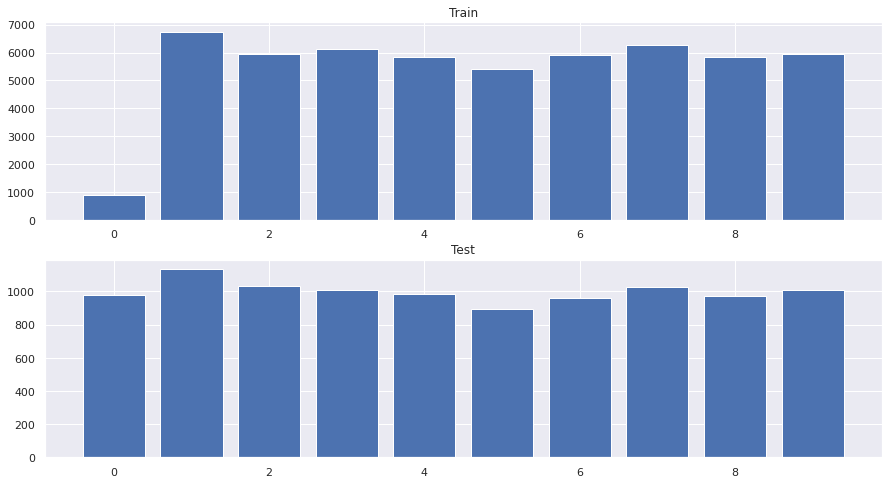

In [ ]:
fig = plt.figure(figsize=(15,8))

gs = gridspec.GridSpec(2, 1)

ax = plt.subplot(gs[0,0])
ax.bar(class_names, value)
ax.set_title('Train')

ax = plt.subplot(gs[1,0])
ax.bar(class_names, valueT)
ax.set_title('Test')

plt.show()

In [ ]:
# Create the models

input_shape = (28, 28, 1)

vae1 = CVAE1(latent_dim=2, shape=input_shape)
vae2 = CVAE1(latent_dim=16, shape=input_shape)
vae3 = CVAE1(latent_dim=32, shape=input_shape)
vae4 = CVAE1(latent_dim=64, shape=input_shape)

Loss:

\begin{align}
\log p(x) &\geq \mathrm{E}_{Z \sim q(z | x)}\big[−\log q(Z | x) + \log p(x, Z)\big]\\
          &= - \mathrm{KL}\big[ \ q(z | x) \ || \ p(z) \ \big] + \mathrm{E}_{Z \sim q(z | x)}\big[\log p(x | Z)\big] 
\end{align}

Donde:
- $p(z)$ = prior
- $q(z|x)$ = encoding distribution
- $p(x|z)$ = decoding distribution


In [ ]:
def log_loss(x_true, p_x_given_z):
  return (-tf.reduce_sum(p_x_given_z.log_prob(x_true)))

In [ ]:
def compile_and_fit(model, train_dataset, val_dataset, epochs, patience=4):

  early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=patience,
                                                    restore_best_weights=True)

  model.compile(loss=log_loss,
                optimizer=tf.keras.optimizers.Adam())

  history = model.fit(train_dataset, epochs=epochs, validation_data=val_dataset, callbacks=[early_stopping])
  
  IPython.display.clear_output()

  return history

In [ ]:
history1 = compile_and_fit(model=vae1, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history2 = compile_and_fit(model=vae2, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history3 = compile_and_fit(model=vae3, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history4 = compile_and_fit(model=vae4, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)

In [ ]:
df1 = pd.DataFrame(history1.history)
df2 = pd.DataFrame(history2.history)
df3 = pd.DataFrame(history3.history)
df4 = pd.DataFrame(history4.history)

In [ ]:
def plot(df1, df2, df3, df4):
    
  fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
  fig.suptitle('Learning curves', fontsize=16, y=1.04)

  ax[0].plot(df1.index, df1['loss'], label='model1_loss')
  ax[0].plot(df2.index, df2['loss'], label='model2_loss')
  ax[0].plot(df3.index, df3['loss'], label='model3_loss')
  ax[0].plot(df4.index, df4['loss'], label='model4_loss')
  ax[0].set_ylabel('Loss'); ax[0].set_xlabel('Epoch')
  ax[0].set_title('Loss')
  ax[0].legend()

  ax[1].plot(df1.index, df1['val_loss'], label='model1_val_loss')
  ax[1].plot(df2.index, df2['val_loss'], label='model2_val_loss')
  ax[1].plot(df3.index, df3['val_loss'], label='model3_val_loss')
  ax[1].plot(df4.index, df4['val_loss'], label='model4_val_loss')
  ax[1].set_ylabel('Loss'); ax[0].set_xlabel('Epoch')
  ax[1].set_title('Validation Loss')
  ax[1].legend()

  plt.tight_layout()
  plt.show()

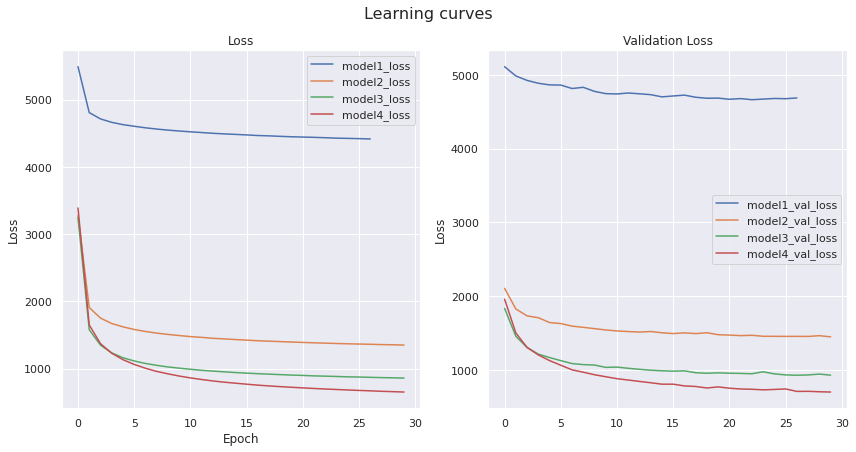

In [ ]:
plot(df1, df2, df3, df4)

In [ ]:
def get_embeddings(encoder1, encoder2, encoder3, encoder4, example_images):

  embedding_1 = encoder1(example_images).mean().numpy()
  embedding_2 = encoder2(example_images).mean().numpy()
  embedding_3 = encoder3(example_images).mean().numpy()
  embedding_4 = encoder4(example_images).mean().numpy()

  return embedding_1, embedding_2, embedding_3, embedding_4

In [ ]:
embedding_1, embedding_2, embedding_3, embedding_4 = get_embeddings(encoder1=vae1.encoder, 
                                                                    encoder2=vae2.encoder, 
                                                                    encoder3=vae3.encoder, 
                                                                    encoder4=vae4.encoder, 
                                                                    example_images=example_images)

In [ ]:
def get_img_reconstructed(model1, model2, model3, model4, example_images):

  img_reconstructed_1 = model1(example_images).mean().numpy().squeeze()
  img_reconstructed_2 = model2(example_images).mean().numpy().squeeze()
  img_reconstructed_3 = model3(example_images).mean().numpy().squeeze()
  img_reconstructed_4 = model4(example_images).mean().numpy().squeeze()

  return img_reconstructed_1, img_reconstructed_2, img_reconstructed_3, img_reconstructed_4

In [ ]:
img_reconstructed_1, img_reconstructed_2, img_reconstructed_3, img_reconstructed_4 = get_img_reconstructed(model1=vae1, 
                                                                                                           model2=vae2, 
                                                                                                           model3=vae3, 
                                                                                                           model4=vae4, 
                                                                                                           example_images=example_images)

In [ ]:
# Apply PCA for plotting

pca = PCA(n_components=2)

embedding_2 = pca.fit_transform(embedding_2)
embedding_3 = pca.fit_transform(embedding_3)
embedding_4 = pca.fit_transform(embedding_4)

In [ ]:
def plot_embeddings(embedding_1, embedding_2, embedding_3, embedding_4):

  fig, axes = plt.subplots(2, 2, figsize=(16, 12))
  fig.suptitle('Embeddings', fontsize=16, y=1.04)

  ax = axes.flatten()

  sns.scatterplot(x=embedding_1[:, 0],
                  y=embedding_1[:, 1],
                  hue=class_names[example_labels].squeeze(), ax=ax[0],
                  palette=sns.color_palette("colorblind", 10));
  ax[0].set_xlabel('Encoding dimension 1'); ax[0].set_ylabel('Encoding dimension 2')
  ax[0].set_title('Encodings of example images with latent_dim=2')

  sns.scatterplot(x=embedding_2[:, 0],
                  y=embedding_2[:, 1],
                  hue=class_names[example_labels].squeeze(), ax=ax[1],
                  palette=sns.color_palette("colorblind", 10));
  ax[1].set_xlabel('Encoding dimension 1'); ax[1].set_ylabel('Encoding dimension 2')
  ax[1].set_title('Encodings of example images with latent_dim=16')

  sns.scatterplot(x=embedding_3[:, 0],
                  y=embedding_3[:, 1],
                  hue=class_names[example_labels].squeeze(), ax=ax[2],
                  palette=sns.color_palette("colorblind", 10));
  ax[2].set_xlabel('Encoding dimension 1'); ax[2].set_ylabel('Encoding dimension 2')
  ax[2].set_title('Encodings of example images with latent_dim=32')

  sns.scatterplot(x=embedding_4[:, 0],
                  y=embedding_4[:, 1],
                  hue=class_names[example_labels].squeeze(), ax=ax[3],
                  palette=sns.color_palette("colorblind", 10));
  ax[3].set_xlabel('Encoding dimension 1'); ax[3].set_ylabel('Encoding dimension 2')
  ax[3].set_title('Encodings of example images with latent_dim=64')

  plt.tight_layout()
  plt.show()

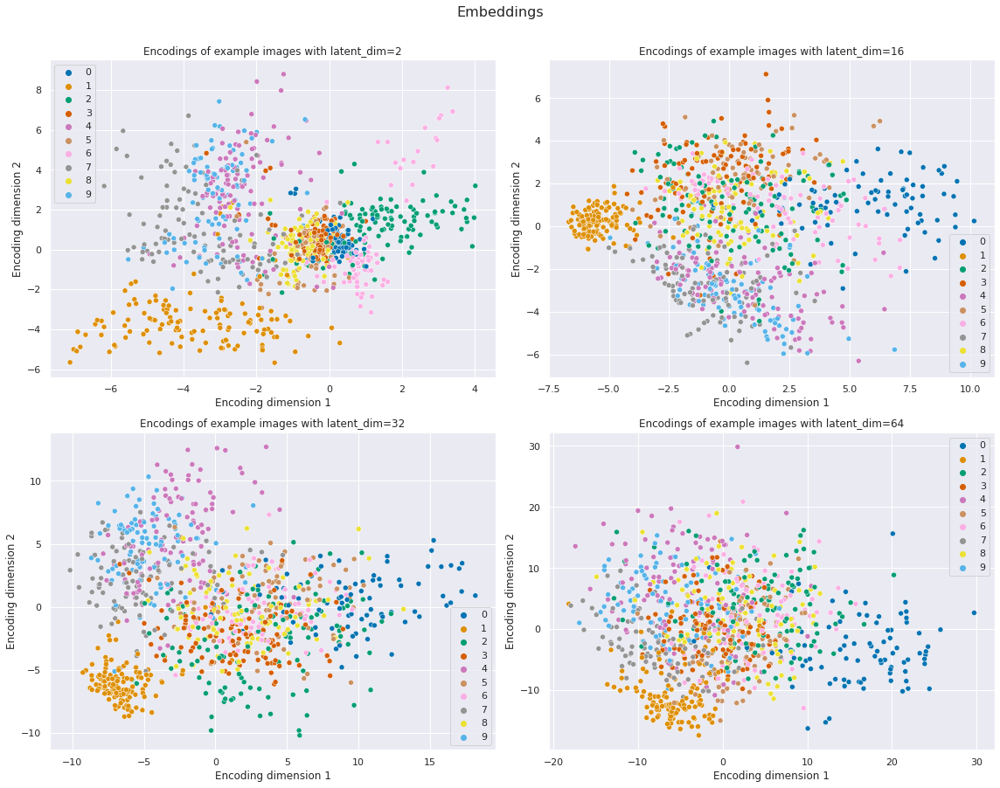

In [ ]:
plot_embeddings(embedding_1=embedding_1, 
                embedding_2=embedding_2, 
                embedding_3=embedding_3,
                embedding_4=embedding_4)

In [ ]:
# Plot the example reconstructions

def plot_reconstructions(example_imgs, rec_model1, rec_model2, rec_model3, rec_model4):
  
  fig, axs = plt.subplots(5, 8, figsize=(16, 14))
  fig.suptitle('Example of reconstructions', fontsize=20, y=1.02)

  for j in range(8):
      axs[0, j].imshow(example_imgs[j, :, :].squeeze(), cmap='gray')
      axs[1, j].imshow(rec_model1[j, :, :], cmap='gray')
      axs[2, j].imshow(rec_model2[j, :, :], cmap='gray')
      axs[3, j].imshow(rec_model3[j, :, :], cmap='gray')
      axs[4, j].imshow(rec_model4[j, :, :], cmap='gray')
      axs[0, j].set_title('Input Imagen')
      axs[1, j].set_title('Latent_dim = 2')
      axs[2, j].set_title('Latent_dim = 16')
      axs[3, j].set_title('Latent_dim = 32')
      axs[4, j].set_title('Latent_dim = 64')
      axs[0, j].axis('off')
      axs[1, j].axis('off')
      axs[2, j].axis('off')
      axs[3, j].axis('off')
      axs[4, j].axis('off')

  plt.tight_layout()
  plt.show()

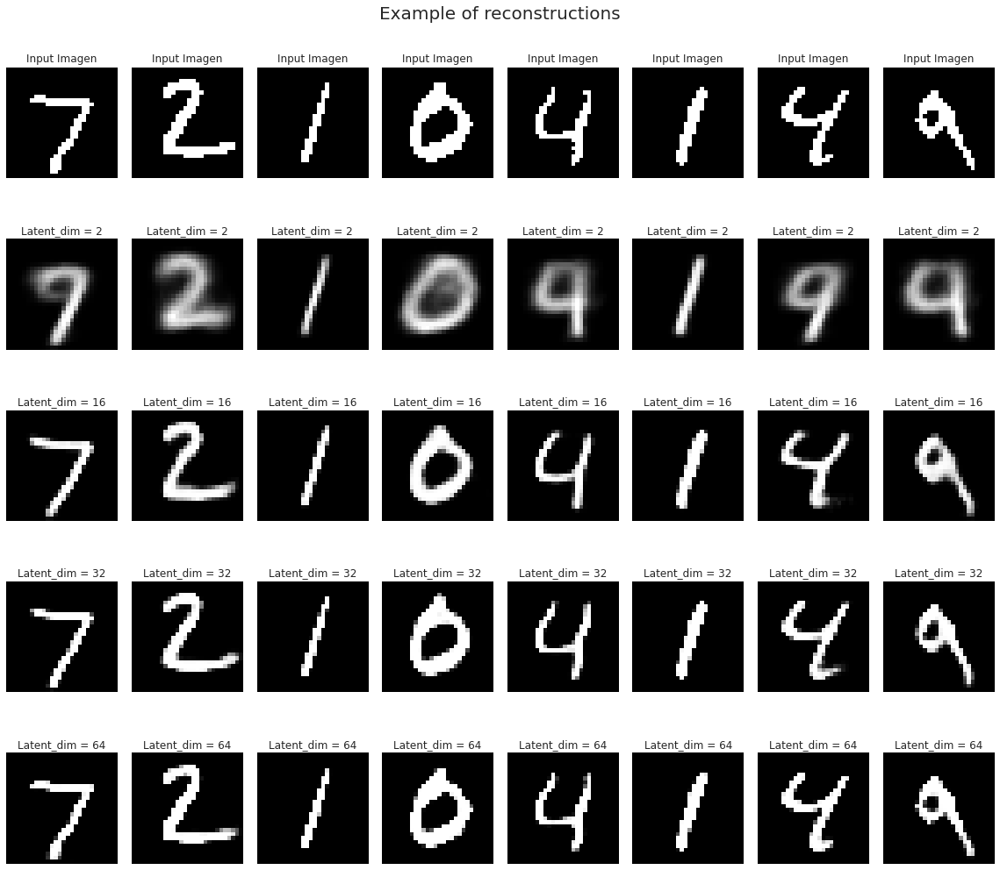

In [ ]:
plot_reconstructions(example_imgs=example_images, 
                     rec_model1=img_reconstructed_1,
                     rec_model2=img_reconstructed_2, 
                     rec_model3=img_reconstructed_3, 
                     rec_model4=img_reconstructed_4)

In [ ]:
# Referencia: https://www.tensorflow.org/tutorials/generative/cvae

def plot_latent_images(model, n, digit_size=28):
  """Plots n x n digit images decoded from the latent space."""

  norm = tfp.distributions.Normal(0, 1)
  grid_x = norm.quantile(np.linspace(0.05, 0.95, n))
  grid_y = norm.quantile(np.linspace(0.05, 0.95, n))
  image_width = digit_size*n
  image_height = image_width
  image = np.zeros((image_height, image_width))

  for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
      z = np.array([[xi, yi]])
      x_decoded = model(z).mean()
      digit = tf.reshape(x_decoded[0], (digit_size, digit_size))
      image[i * digit_size: (i + 1) * digit_size,
            j * digit_size: (j + 1) * digit_size] = digit.numpy()
  plt.figure(figsize=(12, 12))
  plt.imshow(image, cmap='Greys_r')
  plt.axis('Off')
  plt.show()

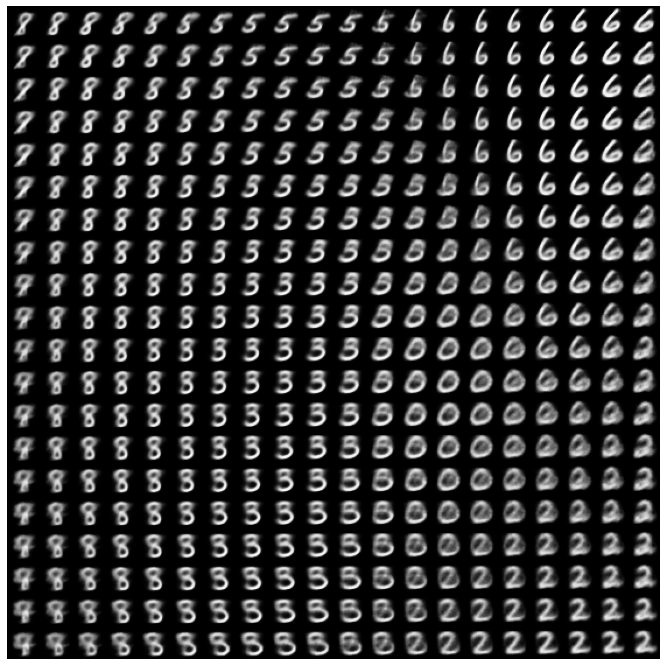

In [ ]:
plot_latent_images(vae1.decoder, 20)

In [ ]:
# Function to create animation
# Referencia: Probabilistic Deep Learning with TensorFlow 2 (Coursera: Capstone Project)

import matplotlib.animation as anim
from IPython.display import HTML

def get_animation(latent_size, decoder, interpolation_length=500):
  
  assert latent_size >= 2, "Latent space must be at least 2-dimensional for plotting"
  fig = plt.figure(figsize=(9, 4))  
  ax1 = fig.add_subplot(1,2,1)
  ax1.set_xlim([-3, 3])
  ax1.set_ylim([-3, 3])
  ax1.set_title("Latent space")
  ax1.axes.get_xaxis().set_visible(False)
  ax1.axes.get_yaxis().set_visible(False)
  ax2 = fig.add_subplot(1,2,2)
  ax2.set_title("Data space")
  ax2.axes.get_xaxis().set_visible(False)
  ax2.axes.get_yaxis().set_visible(False)

  # initializing a image
  z = tf.constant(tf.random.normal(shape=(latent_size, )))
  img_out = np.squeeze(decoder(z[np.newaxis, ...]).mean().numpy())

  # initializing a line variable 
  line, = ax1.plot([], [], marker='o')
  img2 = ax2.imshow(img_out, cmap='gray')

  freqs = np.random.uniform(low=0.1, high=0.2, size=(latent_size, ))
  phases = np.random.randn(latent_size)
  input_points = np.arange(interpolation_length)
  latent_coords = []

  for i in range(latent_size):
    latent_coords.append(2 * np.sin((freqs[i]*input_points + phases[i])).astype(np.float32))
    
  def animate(i):
    z = tf.constant([coord[i] for coord in latent_coords])
    img_out = np.squeeze(decoder(z[np.newaxis, ...]).mean().numpy())
    line.set_data(z.numpy()[0], z.numpy()[1])
    img2.set_data(np.clip(img_out, 0, 1))

    return (line, img2)

  return anim.FuncAnimation(fig, animate, frames=interpolation_length, 
                            repeat=False, blit=True, interval=150)

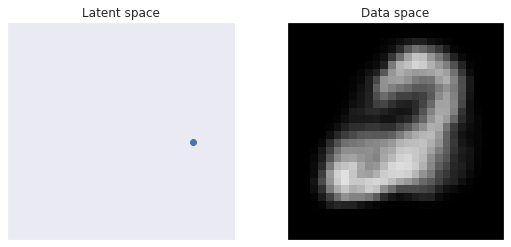

In [ ]:
# Create the animation

a = get_animation(latent_size=2, decoder=vae1.decoder, interpolation_length=200)
HTML(a.to_html5_video())

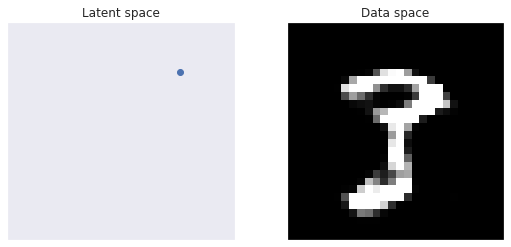

In [ ]:
a = get_animation(latent_size=16, decoder=vae2.decoder, interpolation_length=200)
HTML(a.to_html5_video())

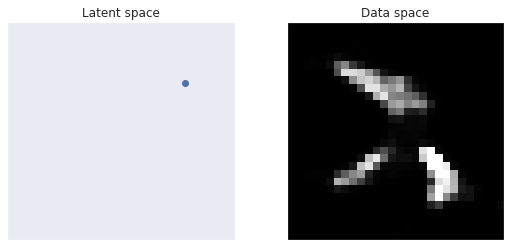

In [ ]:
a = get_animation(latent_size=32, decoder=vae3.decoder, interpolation_length=200)
HTML(a.to_html5_video())

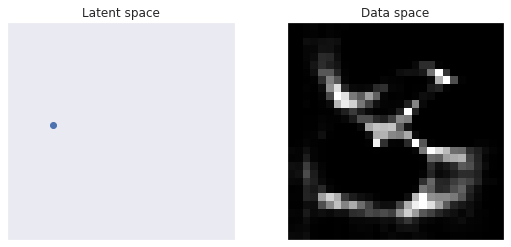

In [ ]:
a = get_animation(latent_size=64, decoder=vae4.decoder, interpolation_length=200)
HTML(a.to_html5_video())

In [ ]:
# Plot 100 generate images

def plot_generate_images(prior, decoder, title):

  n_samples = 100
  embeddings = prior.sample(n_samples)
  sampled_images = decoder(embeddings).mean().numpy().squeeze()

  fig = plt.figure(figsize=(16, 12), facecolor='w', edgecolor='k')
  gs = gridspec.GridSpec(nrows=10, ncols=10)
  fig.suptitle(f'Images generates from {title}', fontsize=20, y=1.03)

  for i in range(n_samples):
    ax = plt.subplot(gs[i//10, i%10])
    ax.imshow(sampled_images[i], cmap='gray')
    ax.axis('off')
      
  plt.tight_layout()
  plt.show()

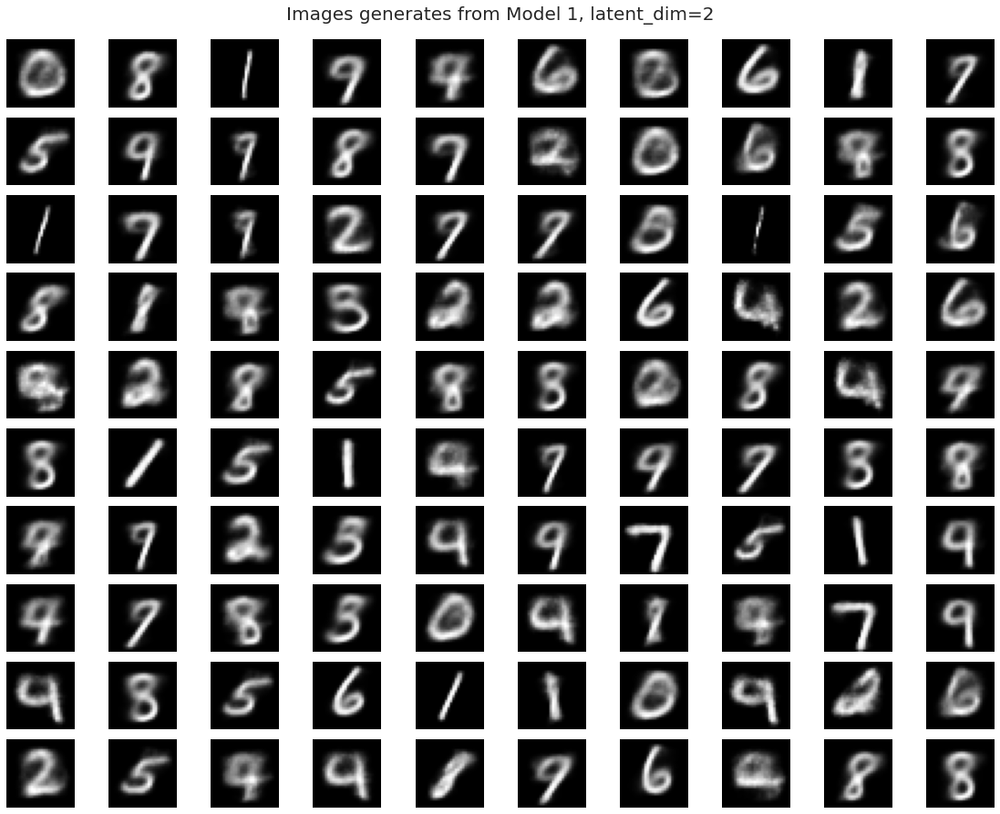

In [ ]:
plot_generate_images(prior=vae1.prior, decoder=vae1.decoder, title='Model 1, latent_dim=2')

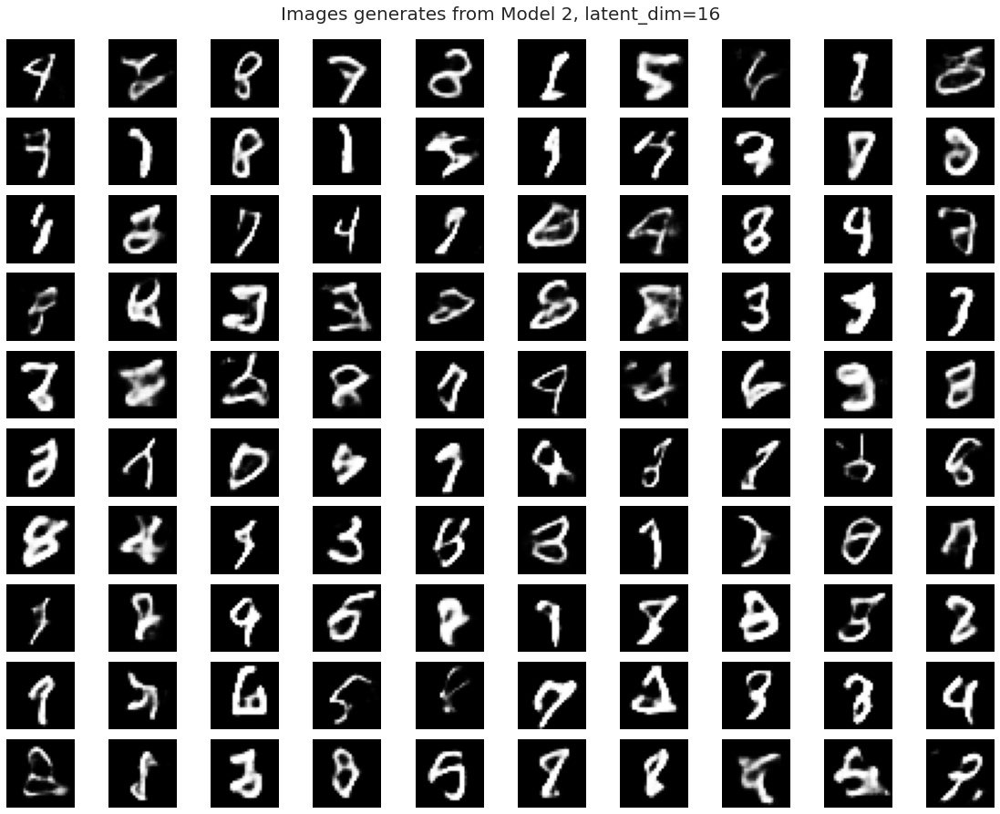

In [ ]:
plot_generate_images(prior=vae2.prior, decoder=vae2.decoder, title='Model 2, latent_dim=16')

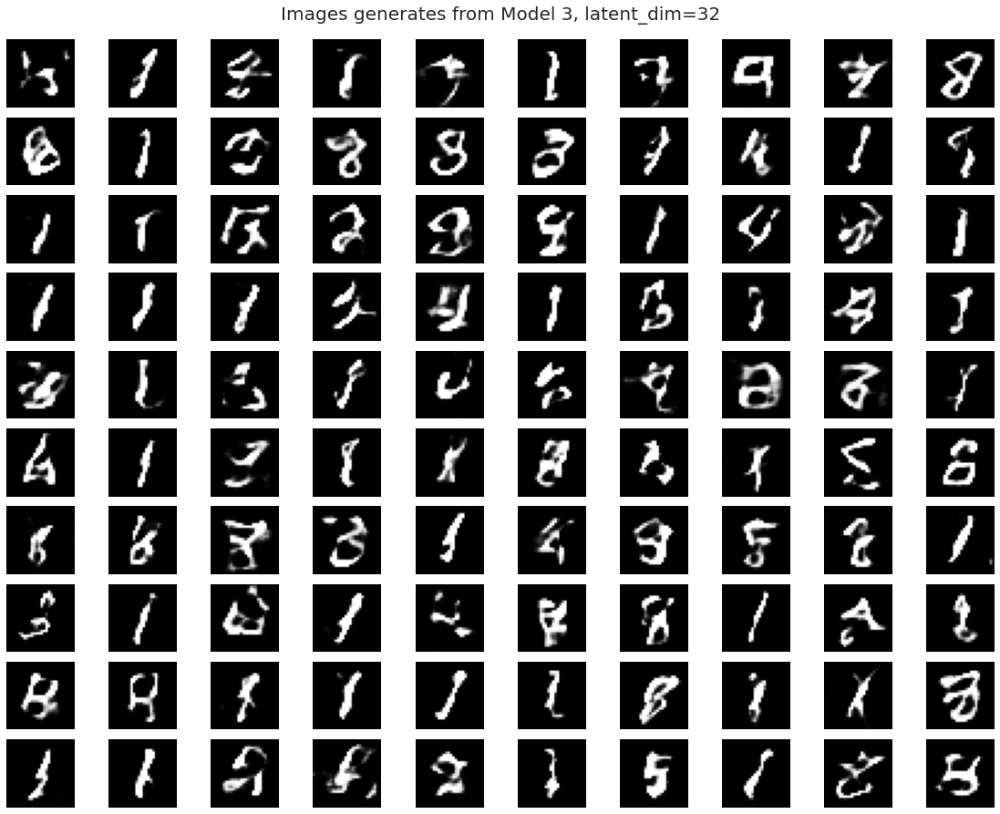

In [ ]:
plot_generate_images(prior=vae3.prior, decoder=vae3.decoder, title='Model 3, latent_dim=32')

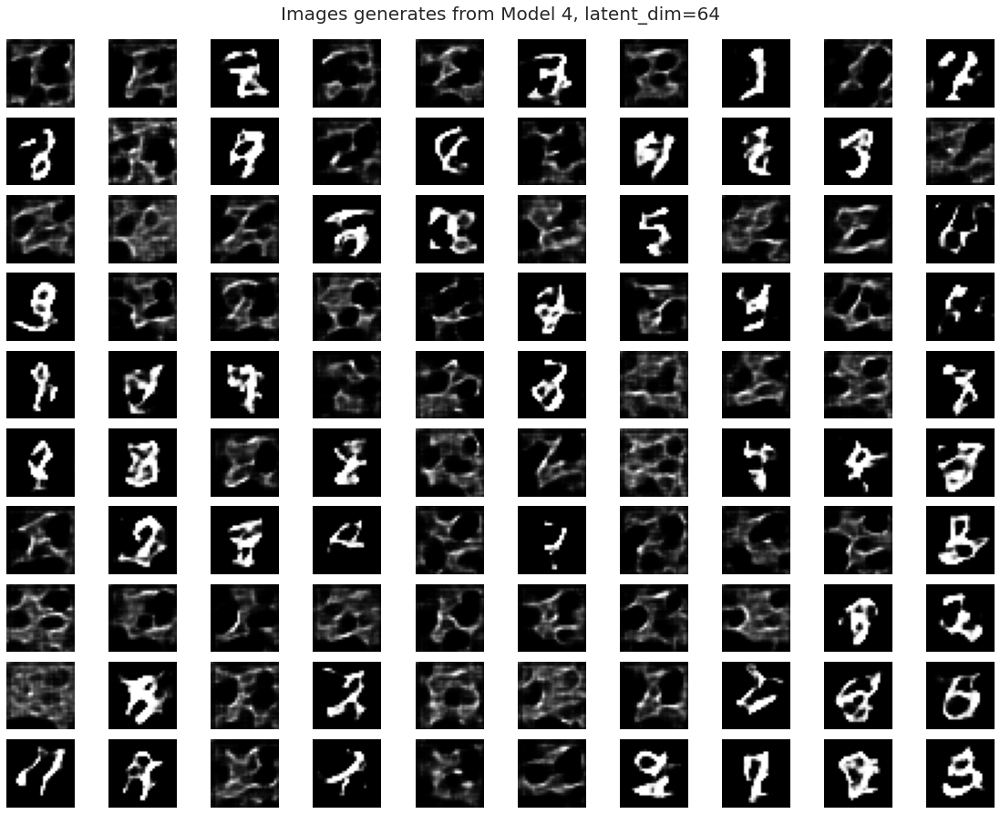

In [ ]:
plot_generate_images(prior=vae4.prior, decoder=vae4.decoder, title='Model 4, latent_dim=64')

### Fashion-MNIST Dataset

In [ ]:
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.fashion_mnist.load_data()

4423680/4422102 [==============================] - 0s 0us/step


In [ ]:
# Unbalancing the dataset

mask_0 = np.where(y_train == 0)[0][:900] # Get first 900 examples of 0
mask = np.isin(y_train, y_train[y_train != 0]) # Get all element without 0

x_train_0 = x_train[mask_0]
y_train_0 = y_train[mask_0]

x_train_ = x_train[mask]
y_train_ = y_train[mask]

x_train = np.concatenate((x_train_0, x_train_))
y_train = np.concatenate((y_train_0, y_train_))

# Counting classes 

target, value = np.unique(y_train, return_counts=True)
targetT, valueT = np.unique(y_test, return_counts=True)
class_names = np.array(['T-shirt/top', 'Trouser/pants', 'Pullover shirt', 'Dress',
                        'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag','Ankle boot'])
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((54900, 28, 28), (10000, 28, 28), (54900,), (10000,))

In [ ]:
x_train = x_train.reshape((x_train.shape[0], 28, 28, 1)) / 255.
x_test = x_test.reshape((x_test.shape[0], 28, 28, 1)) / 255.

train_size = 60000
batch_size = 32
test_size = 10000

train_dataset = tf.data.Dataset.from_tensor_slices((x_train, x_train)).shuffle(train_size).batch(batch_size)
val_dataset = tf.data.Dataset.from_tensor_slices((x_test, x_test)).shuffle(test_size).batch(batch_size)

#Examples to show

n_examples = 1000
example_images = x_test[:n_examples]
example_labels = y_test[:n_examples]

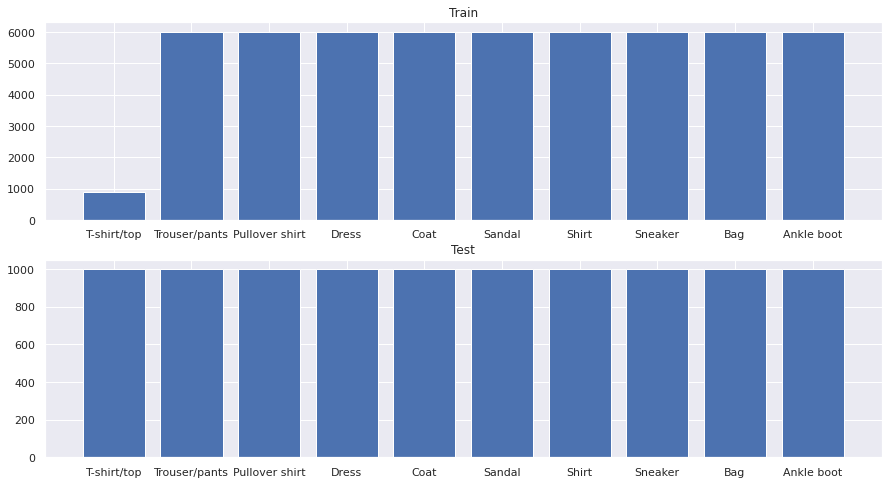

In [ ]:
fig = plt.figure(figsize=(15,8))

gs = gridspec.GridSpec(2, 1)

ax = plt.subplot(gs[0,0])
ax.bar(class_names, value)
ax.set_title('Train')

ax = plt.subplot(gs[1,0])
ax.bar(class_names, valueT)
ax.set_title('Test')

plt.show()

In [ ]:
# Create the models

input_shape = (28, 28, 1)

vae1 = CVAE1(latent_dim=2, shape=input_shape)
vae2 = CVAE1(latent_dim=16, shape=input_shape)
vae3 = CVAE1(latent_dim=32, shape=input_shape)
vae4 = CVAE1(latent_dim=64, shape=input_shape)

In [ ]:
history1 = compile_and_fit(model=vae1, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history2 = compile_and_fit(model=vae2, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history3 = compile_and_fit(model=vae3, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history4 = compile_and_fit(model=vae4, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)

In [ ]:
df1 = pd.DataFrame(history1.history)
df2 = pd.DataFrame(history2.history)
df3 = pd.DataFrame(history3.history)
df4 = pd.DataFrame(history4.history)

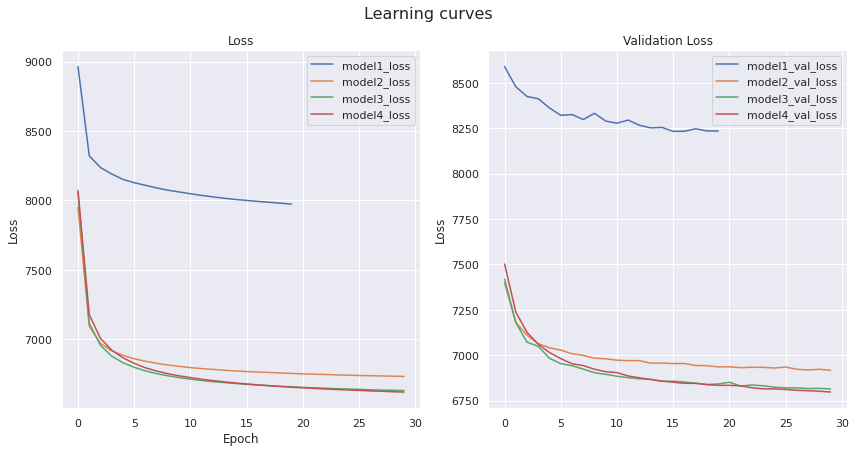

In [ ]:
plot(df1, df2, df3, df4)

In [ ]:
embedding_1, embedding_2, embedding_3, embedding_4 = get_embeddings(encoder1=vae1.encoder, 
                                                                    encoder2=vae2.encoder, 
                                                                    encoder3=vae3.encoder, 
                                                                    encoder4=vae4.encoder, 
                                                                    example_images=example_images)

In [ ]:
img_reconstructed_1, img_reconstructed_2, img_reconstructed_3, img_reconstructed_4 = get_img_reconstructed(model1=vae1, 
                                                                                                           model2=vae2, 
                                                                                                           model3=vae3, 
                                                                                                           model4=vae4, 
                                                                                                           example_images=example_images)

In [ ]:
# Apply PCA for plotting

pca = PCA(n_components=2)

embedding_2 = pca.fit_transform(embedding_2)
embedding_3 = pca.fit_transform(embedding_3)
embedding_4 = pca.fit_transform(embedding_4)

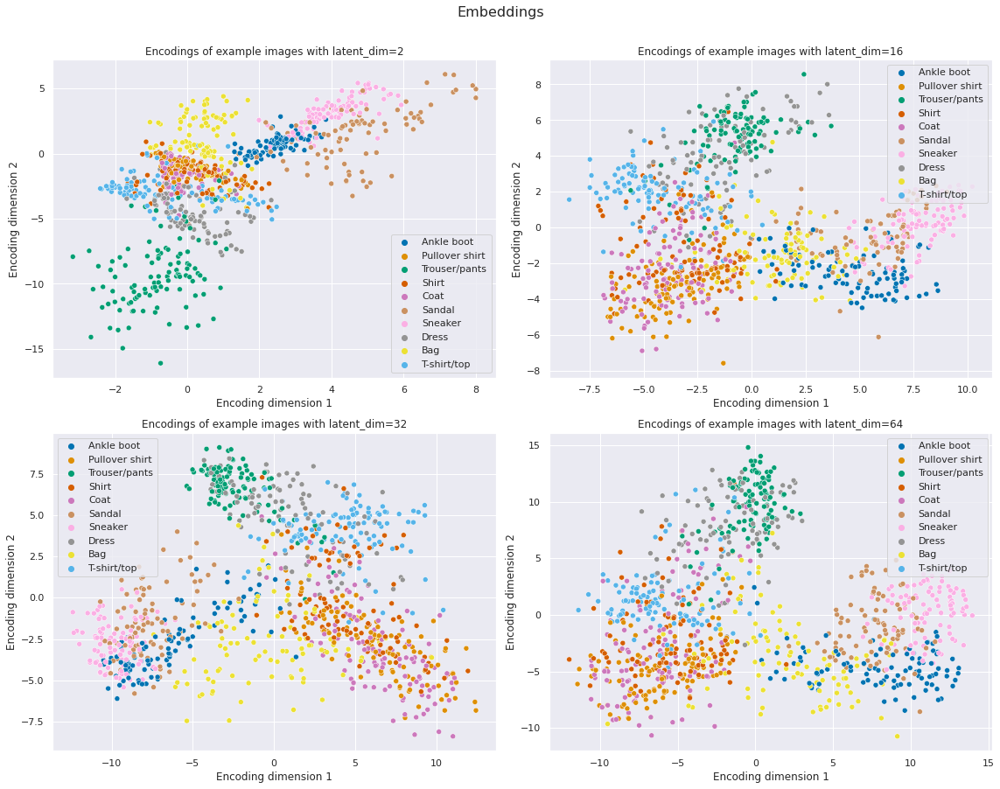

In [ ]:
plot_embeddings(embedding_1=embedding_1, 
                embedding_2=embedding_2, 
                embedding_3=embedding_3,
                embedding_4=embedding_4)

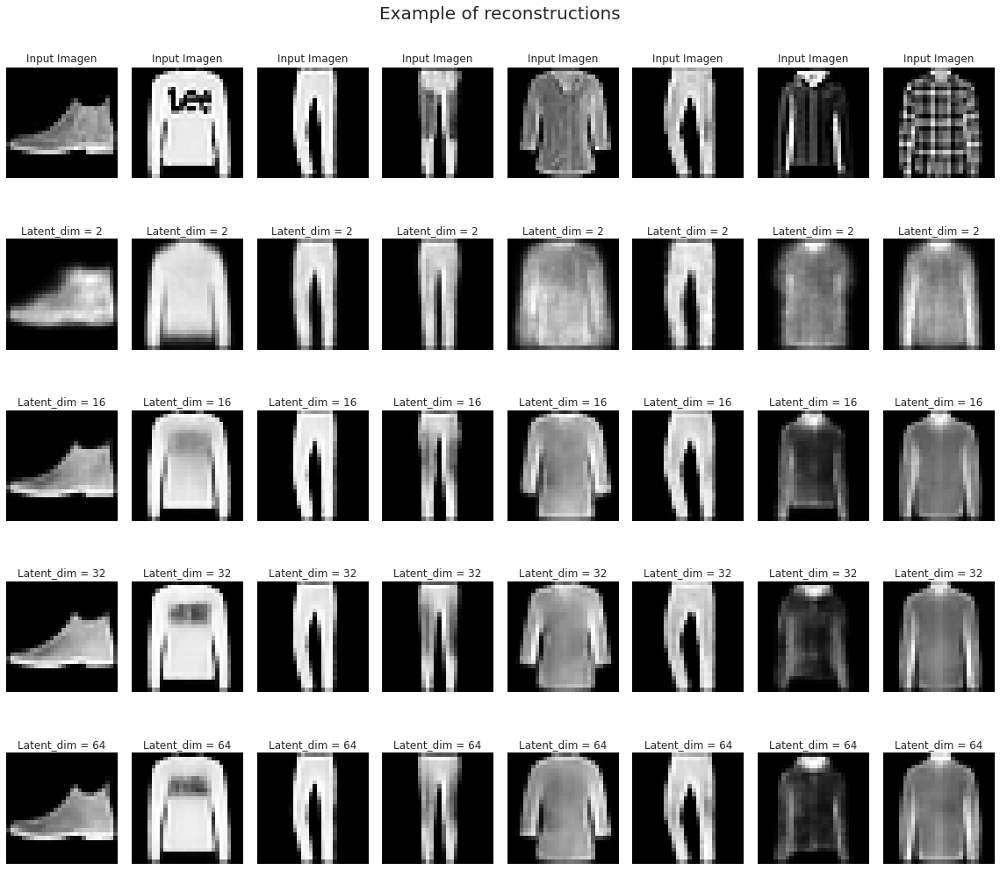

In [ ]:
# Plot the example reconstructions

plot_reconstructions(example_imgs=example_images, 
                     rec_model1=img_reconstructed_1,
                     rec_model2=img_reconstructed_2, 
                     rec_model3=img_reconstructed_3, 
                     rec_model4=img_reconstructed_4)

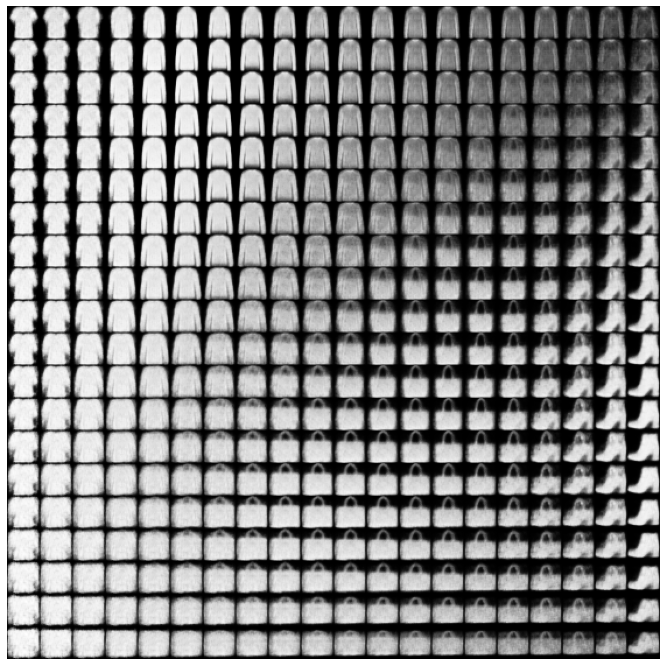

In [ ]:
plot_latent_images(vae1.decoder, 20)

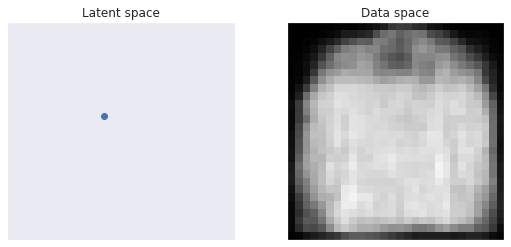

In [ ]:
# Create the animation

a = get_animation(latent_size=2, decoder=vae1.decoder, interpolation_length=200)
HTML(a.to_html5_video())

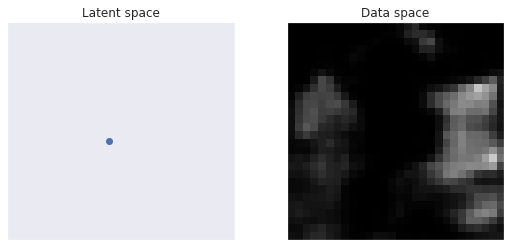

In [ ]:
a = get_animation(latent_size=16, decoder=vae2.decoder, interpolation_length=200)
HTML(a.to_html5_video())

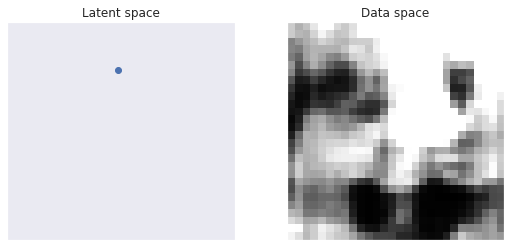

In [ ]:
a = get_animation(latent_size=32, decoder=vae3.decoder, interpolation_length=200)
HTML(a.to_html5_video())

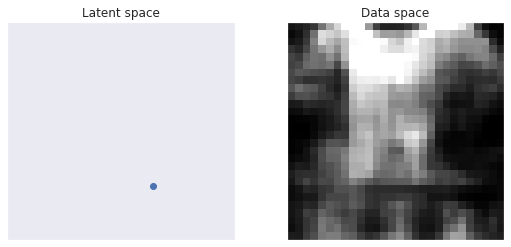

In [ ]:
a = get_animation(latent_size=64, decoder=vae4.decoder, interpolation_length=200)
HTML(a.to_html5_video())

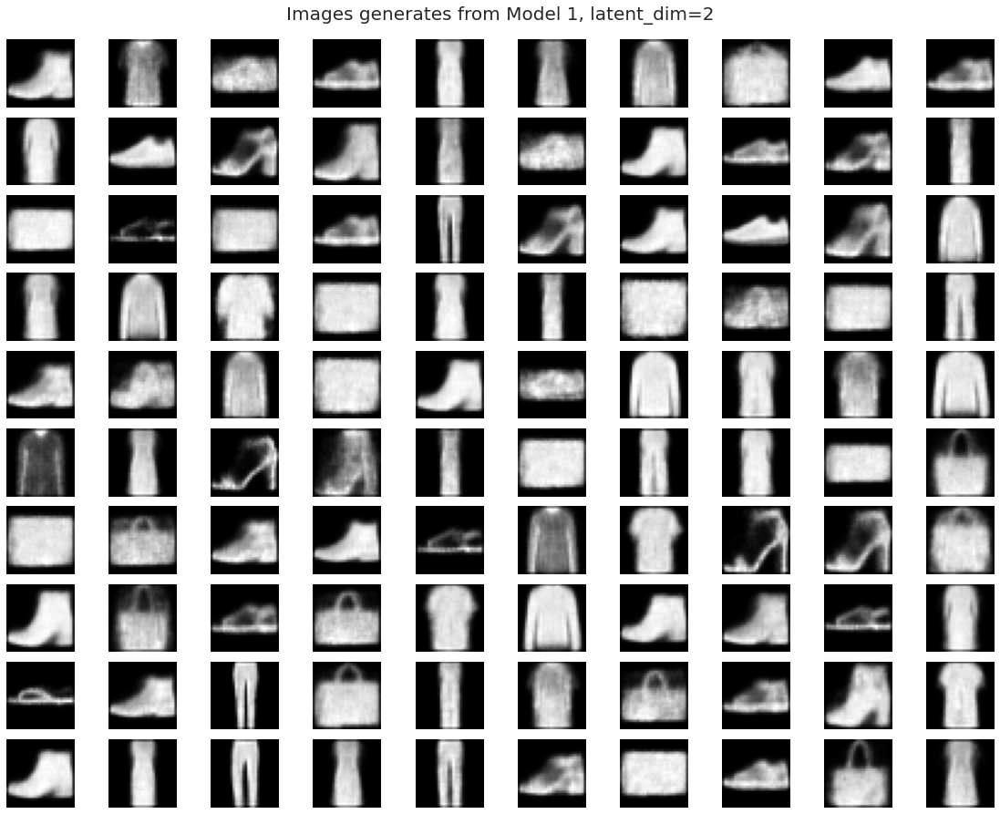

In [ ]:
plot_generate_images(prior=vae1.prior, decoder=vae1.decoder, title='Model 1, latent_dim=2')

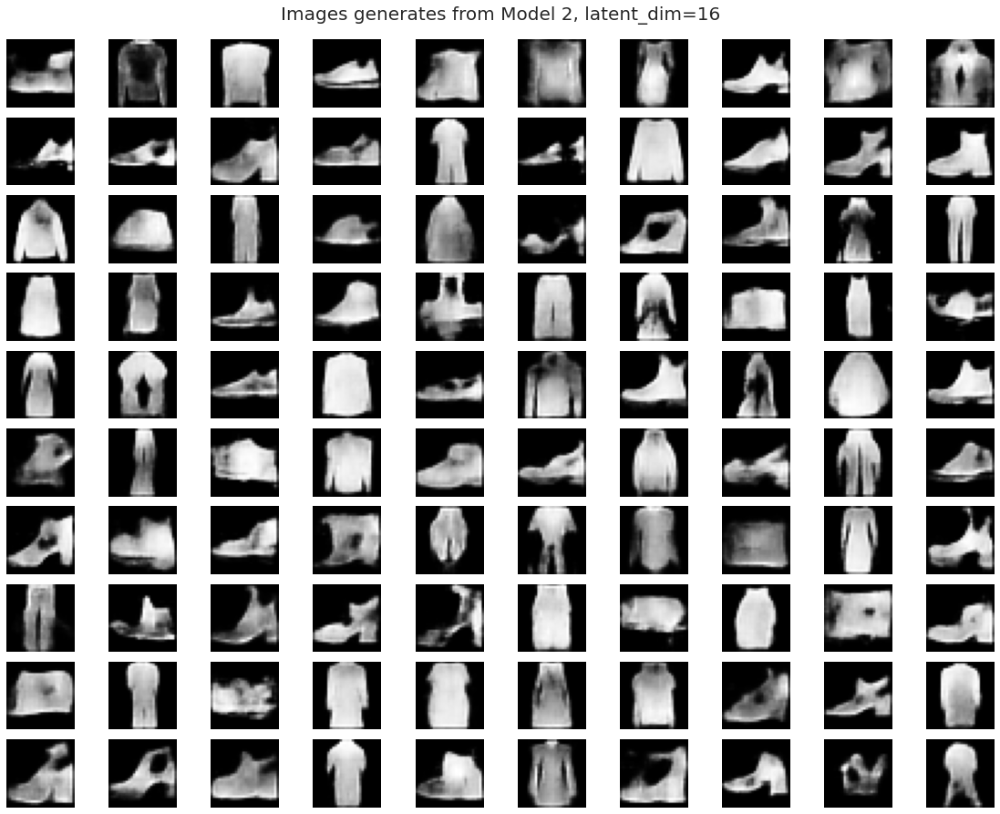

In [ ]:
plot_generate_images(prior=vae2.prior, decoder=vae2.decoder, title='Model 2, latent_dim=16')

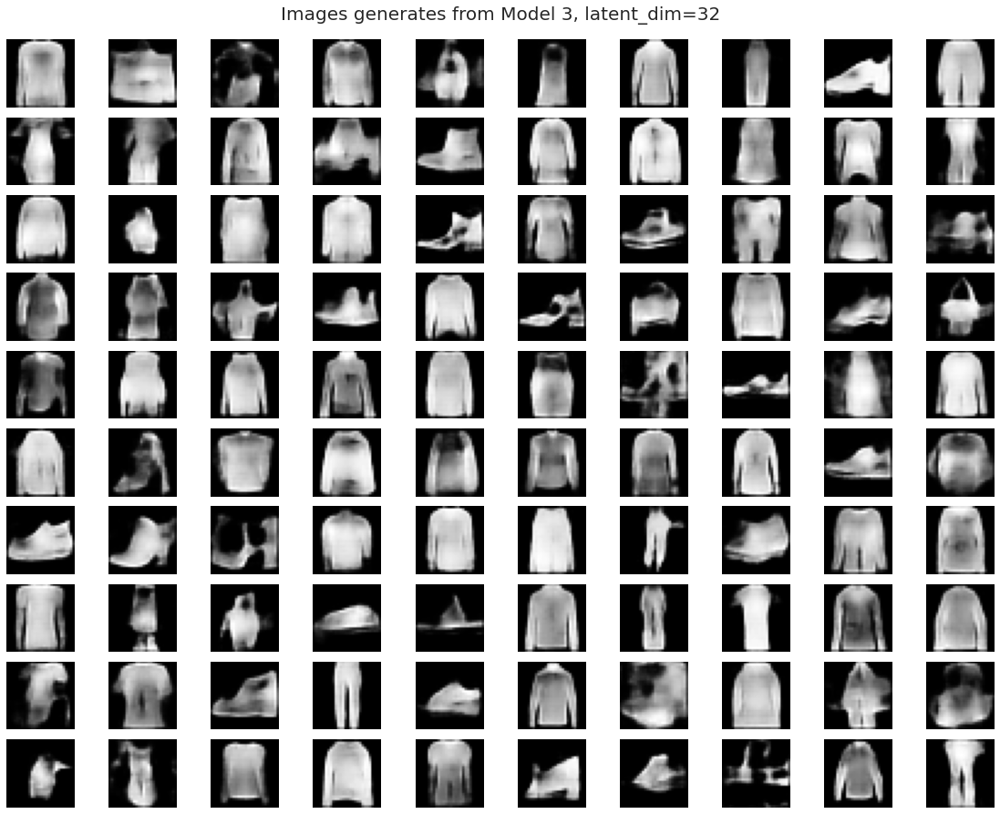

In [ ]:
plot_generate_images(prior=vae3.prior, decoder=vae3.decoder, title='Model 3, latent_dim=32')

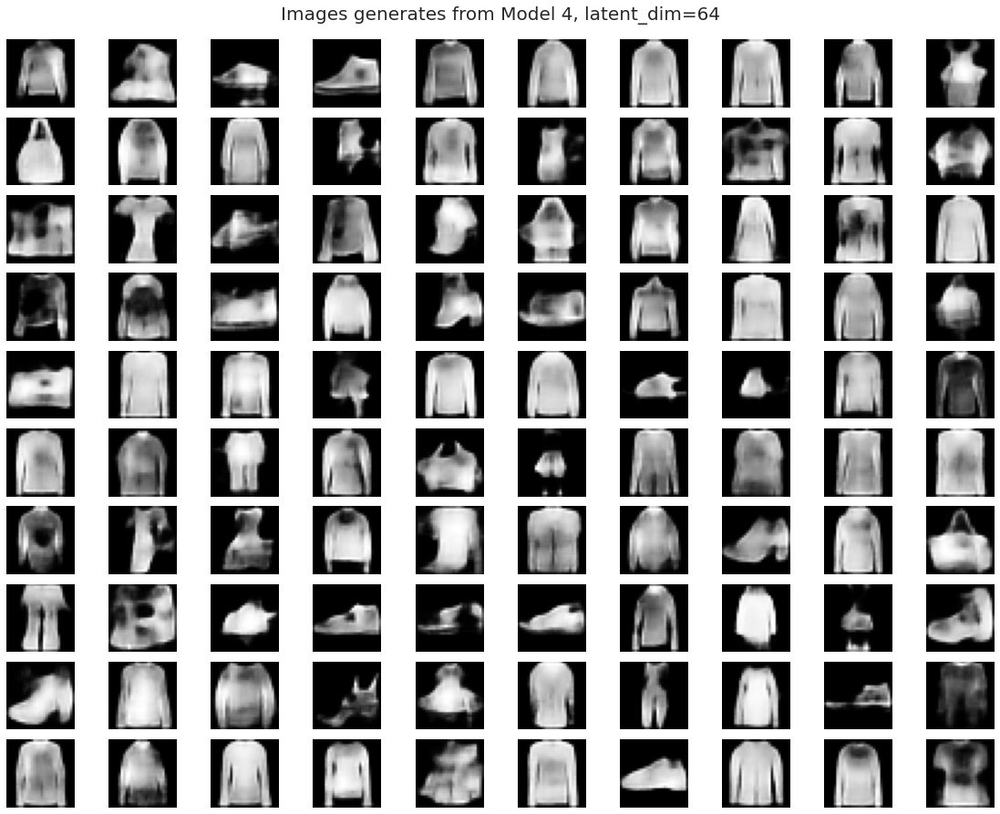

In [ ]:
plot_generate_images(prior=vae4.prior, decoder=vae4.decoder, title='Model 4, latent_dim=64')

### Cifar 10 Dataset - 1

In [ ]:
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()

In [ ]:
# Unbalancing the dataset

mask_0 = np.where(y_train == 0)[0][:900] # Get first 900 examples of 0
mask = np.where(y_train != 0)[0] # Get all element without 0

x_train_0 = x_train[mask_0]
y_train_0 = y_train[mask_0]
x_train_ = x_train[mask]
y_train_ = y_train[mask]

x_train = np.concatenate((x_train_0, x_train_))
y_train = np.concatenate((y_train_0, y_train_))

# Counting classes 

target, value = np.unique(y_train, return_counts=True)
targetT, valueT = np.unique(y_test, return_counts=True)
class_names = np.array(['Airplane', 'Automobile', 'Bird', 'Cat', 'Deer', 'Dog', 'Frog', 'Horse', 'Ship', 'Truck'])
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((45900, 32, 32, 3), (10000, 32, 32, 3), (45900, 1), (10000, 1))

In [ ]:
x_train = x_train / 255.
x_test = x_test / 255.

train_size = 50000
batch_size = 32
test_size = 10000

train_dataset = tf.data.Dataset.from_tensor_slices((x_train, x_train)).shuffle(train_size).batch(batch_size)
val_dataset = tf.data.Dataset.from_tensor_slices((x_test, x_test)).shuffle(test_size).batch(batch_size)

#Examples to show

n_examples = 1000
example_images = x_test[:n_examples]
example_labels = y_test[:n_examples]

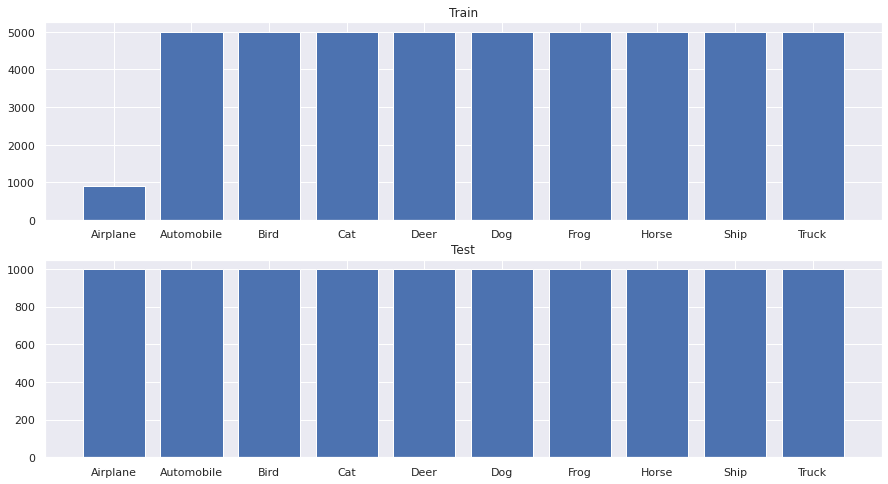

In [ ]:
fig = plt.figure(figsize=(15,8))

gs = gridspec.GridSpec(2, 1)

ax = plt.subplot(gs[0,0])
ax.bar(class_names, value)
ax.set_title('Train')

ax = plt.subplot(gs[1,0])
ax.bar(class_names, valueT)
ax.set_title('Test')

plt.show()

In [ ]:
# Create the models

input_shape = (32, 32, 3)

vae1 = CVAE2(latent_dim=2, shape=input_shape)
vae2 = CVAE2(latent_dim=16, shape=input_shape)
vae3 = CVAE2(latent_dim=32, shape=input_shape)
vae4 = CVAE2(latent_dim=64, shape=input_shape)

In [ ]:
history1 = compile_and_fit(model=vae1, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history2 = compile_and_fit(model=vae2, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history3 = compile_and_fit(model=vae3, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history4 = compile_and_fit(model=vae4, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)

In [ ]:
df1 = pd.DataFrame(history1.history)
df2 = pd.DataFrame(history2.history)
df3 = pd.DataFrame(history3.history)
df4 = pd.DataFrame(history4.history)

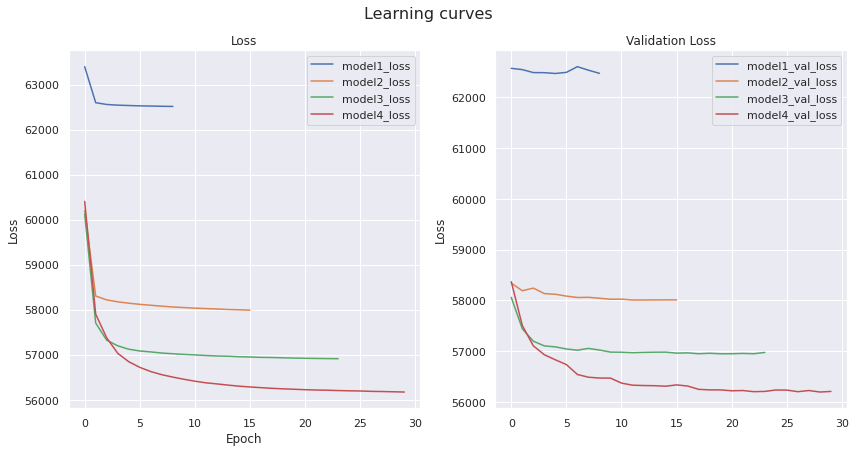

In [ ]:
plot(df1, df2, df3, df4)

In [ ]:
embedding_1, embedding_2, embedding_3, embedding_4 = get_embeddings(encoder1=vae1.encoder, 
                                                                    encoder2=vae2.encoder, 
                                                                    encoder3=vae3.encoder, 
                                                                    encoder4=vae4.encoder, 
                                                                    example_images=example_images)

In [ ]:
img_reconstructed_1, img_reconstructed_2, img_reconstructed_3, img_reconstructed_4 = get_img_reconstructed(model1=vae1, 
                                                                                                           model2=vae2, 
                                                                                                           model3=vae3, 
                                                                                                           model4=vae4, 
                                                                                                           example_images=example_images)

In [ ]:
# Apply PCA for plotting

pca = PCA(n_components=2)

embedding_2 = pca.fit_transform(embedding_2)
embedding_3 = pca.fit_transform(embedding_3)
embedding_4 = pca.fit_transform(embedding_4)

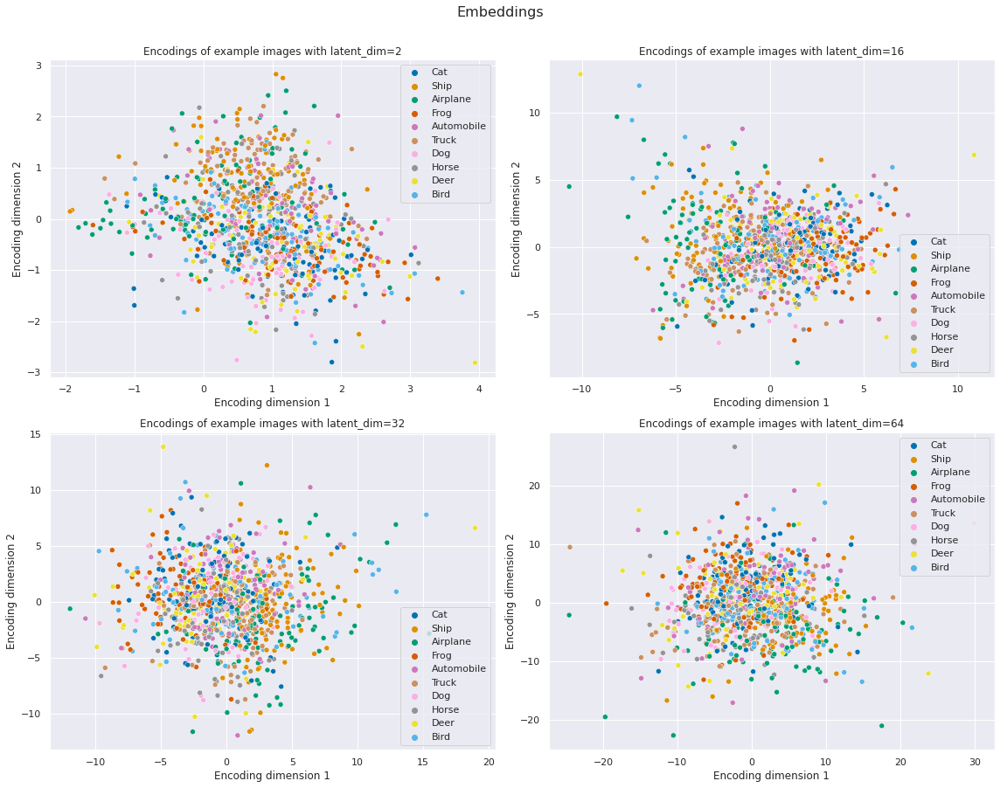

In [ ]:
plot_embeddings(embedding_1=embedding_1, 
                embedding_2=embedding_2, 
                embedding_3=embedding_3,
                embedding_4=embedding_4)

In [ ]:
# Plot the example reconstructions

def plot_reconstructions(example_imgs, rec_model1, rec_model2, rec_model3, rec_model4):
  
  fig, axs = plt.subplots(5, 8, figsize=(16, 14))
  fig.suptitle('Example of reconstructions', fontsize=20, y=1.02)

  for j in range(8):

      axs[0, j].imshow(example_imgs[j, :, :, :])
      axs[1, j].imshow(rec_model1[j, :, :, :])
      axs[2, j].imshow(rec_model2[j, :, :, :])
      axs[3, j].imshow(rec_model3[j, :, :, :])
      axs[4, j].imshow(rec_model4[j, :, :, :])
      axs[0, j].set_title('Input Imagen')
      axs[1, j].set_title('Latent_dim = 2')
      axs[2, j].set_title('Latent_dim = 16')
      axs[3, j].set_title('Latent_dim = 32')
      axs[4, j].set_title('Latent_dim = 64')
      axs[0, j].axis('off')
      axs[1, j].axis('off')
      axs[2, j].axis('off')
      axs[3, j].axis('off')
      axs[4, j].axis('off')

  plt.tight_layout()
  plt.show()

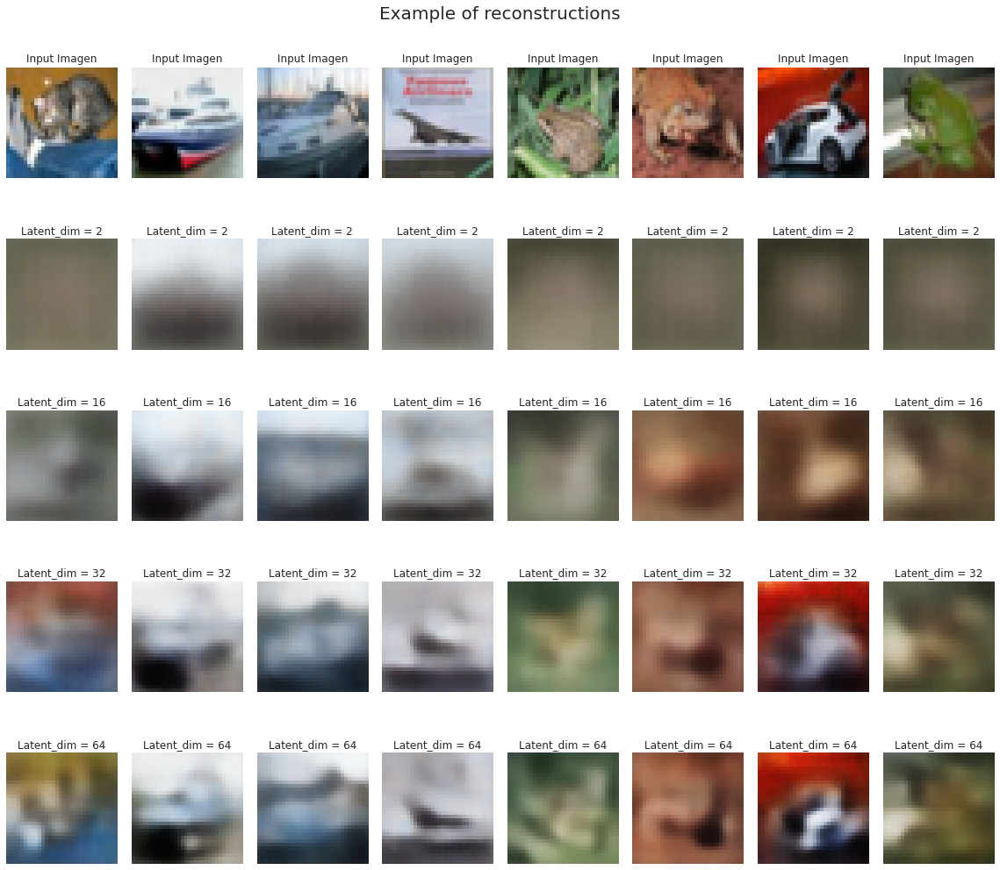

In [ ]:
# Plot the example reconstructions

plot_reconstructions(example_imgs=example_images, 
                     rec_model1=img_reconstructed_1,
                     rec_model2=img_reconstructed_2, 
                     rec_model3=img_reconstructed_3, 
                     rec_model4=img_reconstructed_4)

In [ ]:
def plot_latent_images(model, n, digit_size=32):
  """Plots n x n digit images decoded from the latent space."""

  norm = tfp.distributions.Normal(0, 1)
  grid_x = norm.quantile(np.linspace(0.05, 0.95, n))
  grid_y = norm.quantile(np.linspace(0.05, 0.95, n))
  image_width = digit_size*n
  image_height = image_width
  image = np.zeros((image_height, image_width, 3))

  for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
      z = np.array([[xi, yi]])
      x_decoded = model(z).mean()
      digit = tf.reshape(x_decoded[0], (digit_size, digit_size, 3))
      image[i * digit_size: (i + 1) * digit_size,
            j * digit_size: (j + 1) * digit_size] = digit.numpy()
  plt.figure(figsize=(12, 12))
  plt.imshow(image)
  plt.axis('Off')
  plt.show()

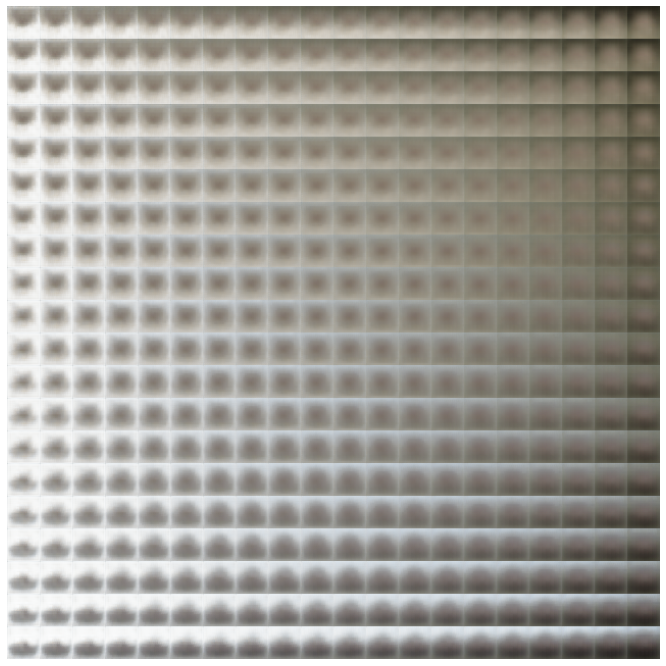

In [ ]:
plot_latent_images(vae1.decoder, 20)

In [ ]:
import matplotlib.animation as anim
from IPython.display import HTML

def get_animation(latent_size, decoder, interpolation_length=500):
  
  assert latent_size >= 2, "Latent space must be at least 2-dimensional for plotting"
  fig = plt.figure(figsize=(9, 4))  
  ax1 = fig.add_subplot(1,2,1)
  ax1.set_xlim([-3, 3])
  ax1.set_ylim([-3, 3])
  ax1.set_title("Latent space")
  ax1.axes.get_xaxis().set_visible(False)
  ax1.axes.get_yaxis().set_visible(False)
  ax2 = fig.add_subplot(1,2,2)
  ax2.set_title("Data space")
  ax2.axes.get_xaxis().set_visible(False)
  ax2.axes.get_yaxis().set_visible(False)

  # initializing a image
  z = tf.constant(tf.random.normal(shape=(latent_size, )))
  img_out = np.squeeze(decoder(z[np.newaxis, ...]).mean().numpy())

  # initializing a line variable 
  line, = ax1.plot([], [], marker='o')
  img2 = ax2.imshow(img_out)

  freqs = np.random.uniform(low=0.1, high=0.2, size=(latent_size, ))
  phases = np.random.randn(latent_size)
  input_points = np.arange(interpolation_length)
  latent_coords = []

  for i in range(latent_size):
    latent_coords.append(2 * np.sin((freqs[i]*input_points + phases[i])).astype(np.float32))
    
  def animate(i):
    z = tf.constant([coord[i] for coord in latent_coords])
    img_out = np.squeeze(decoder(z[np.newaxis, ...]).mean().numpy())
    line.set_data(z.numpy()[0], z.numpy()[1])
    img2.set_data(np.clip(img_out, 0, 1))

    return (line, img2)

  return anim.FuncAnimation(fig, animate, frames=interpolation_length, 
                            repeat=False, blit=True, interval=150)

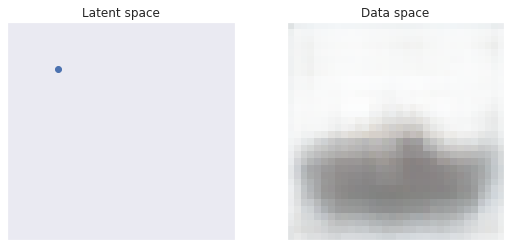

In [ ]:
# Create the animation

a = get_animation(latent_size=2, decoder=vae1.decoder, interpolation_length=200)
HTML(a.to_html5_video())

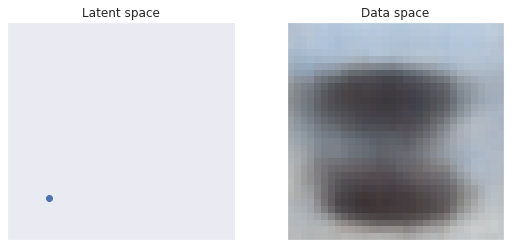

In [ ]:
a = get_animation(latent_size=16, decoder=vae2.decoder, interpolation_length=200)
HTML(a.to_html5_video())

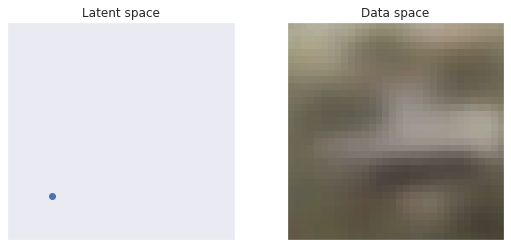

In [ ]:
a = get_animation(latent_size=32, decoder=vae3.decoder, interpolation_length=200)
HTML(a.to_html5_video())

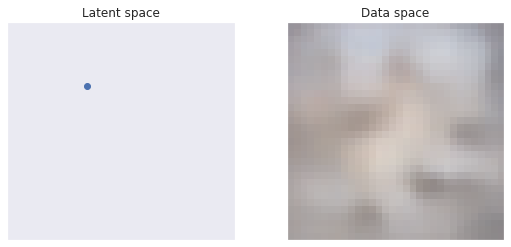

In [ ]:
a = get_animation(latent_size=64, decoder=vae4.decoder, interpolation_length=200)
HTML(a.to_html5_video())

In [ ]:
# Plot 100 generate images

def plot_generate_images(prior, decoder, title):

  n_samples = 100
  embeddings = prior.sample(n_samples)
  sampled_images = decoder(embeddings).mean().numpy().squeeze()

  fig = plt.figure(figsize=(16, 12), facecolor='w', edgecolor='k')
  gs = gridspec.GridSpec(nrows=10, ncols=10)
  fig.suptitle(f'Images generates from {title}', fontsize=20, y=1.03)

  for i in range(n_samples):
    ax = plt.subplot(gs[i//10, i%10])
    ax.imshow(sampled_images[i])
    ax.axis('off')
      
  plt.tight_layout()
  plt.show()

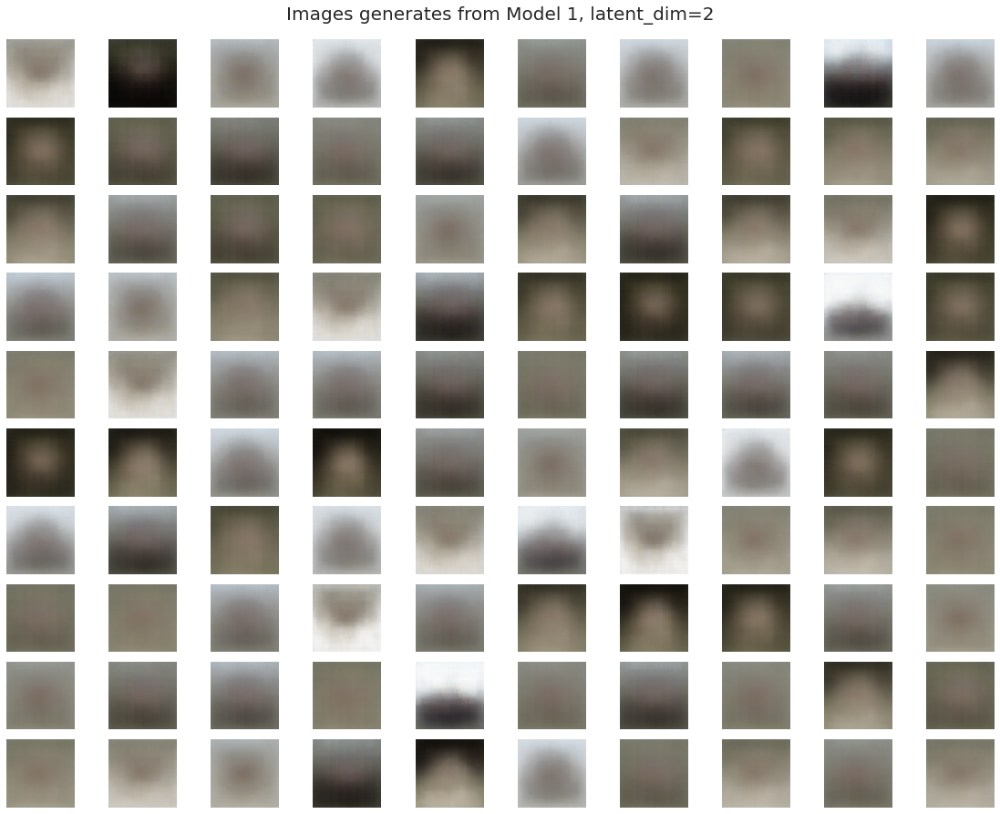

In [ ]:
plot_generate_images(prior=vae1.prior, decoder=vae1.decoder, title='Model 1, latent_dim=2')

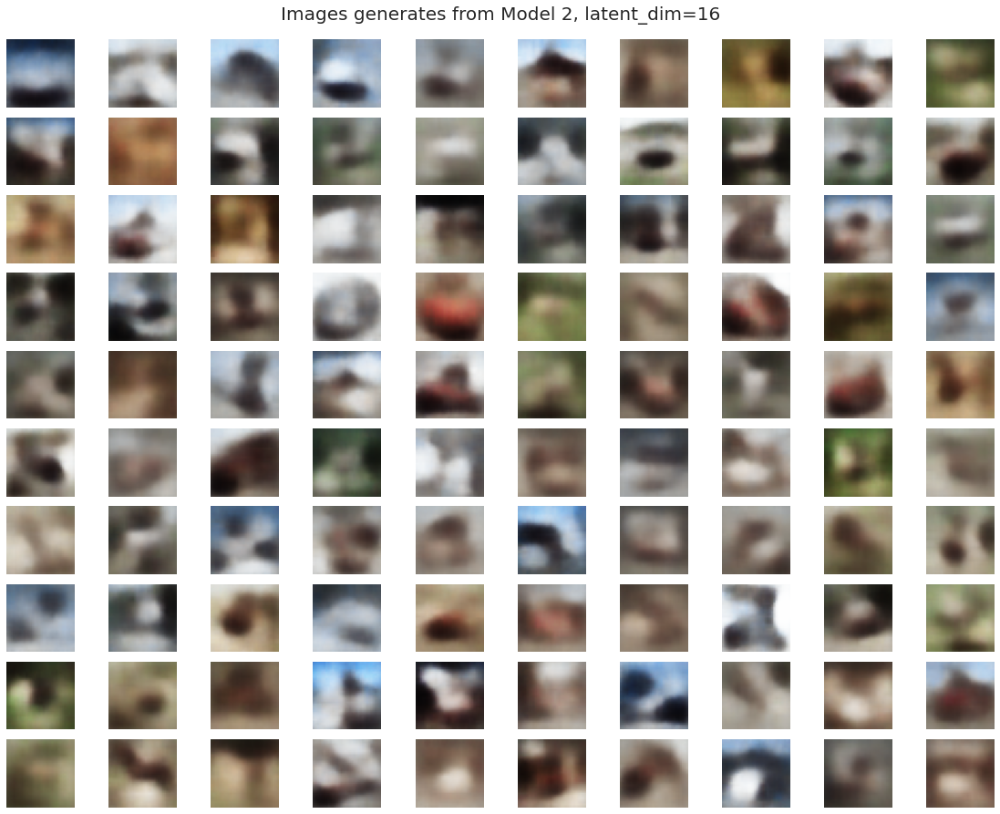

In [ ]:
plot_generate_images(prior=vae2.prior, decoder=vae2.decoder, title='Model 2, latent_dim=16')

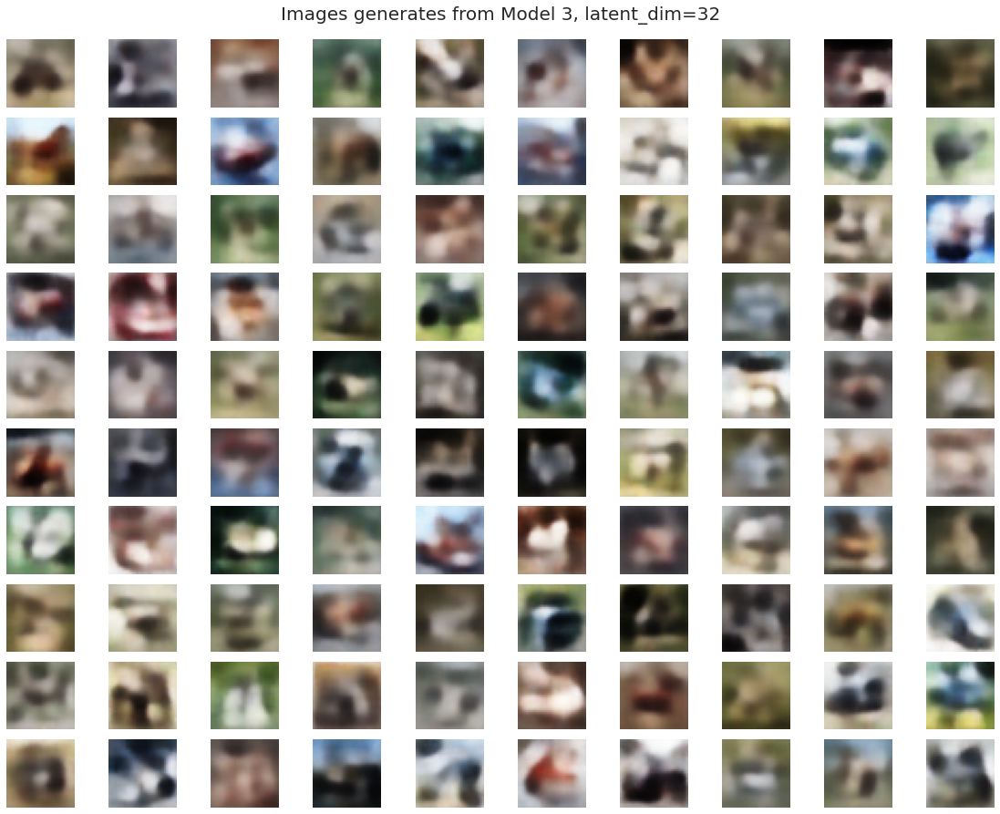

In [ ]:
plot_generate_images(prior=vae3.prior, decoder=vae3.decoder, title='Model 3, latent_dim=32')

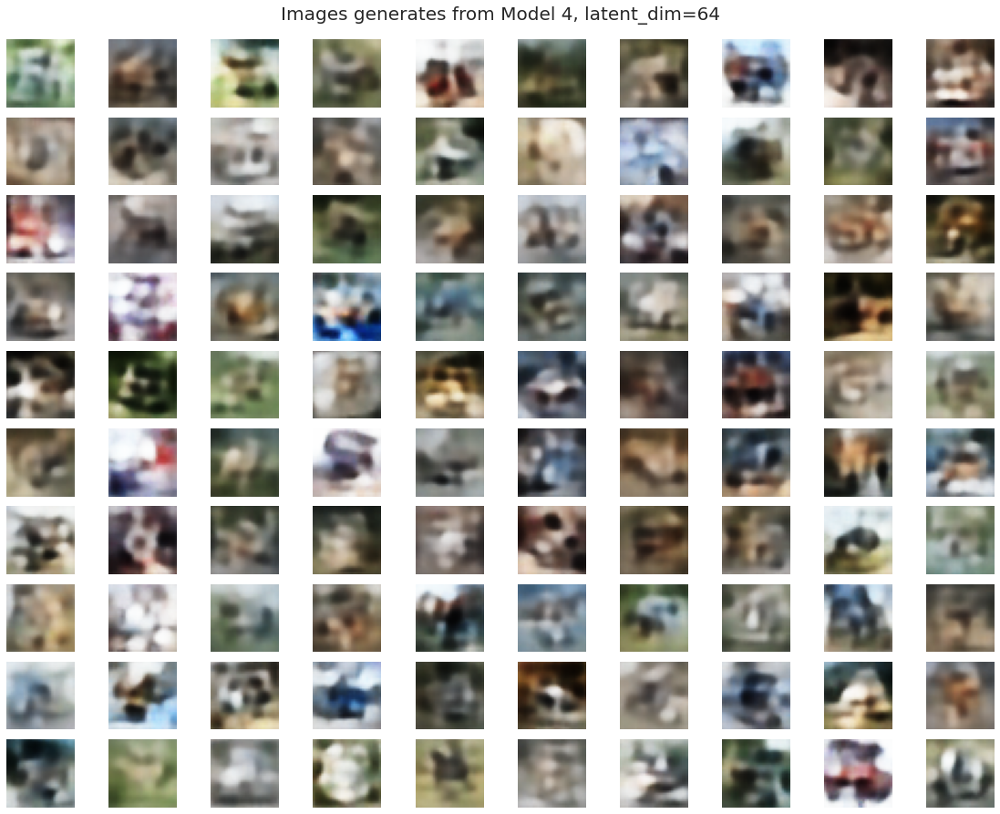

In [ ]:
plot_generate_images(prior=vae4.prior, decoder=vae4.decoder, title='Model 4, latent_dim=64')

#### Cifar 10 Dataset - 2

In [ ]:
# Aumentando la dimension del espacio latente

input_shape = (32, 32, 3)

vae1 = CVAE2(latent_dim=64, shape=input_shape)
vae2 = CVAE2(latent_dim=128, shape=input_shape)
vae3 = CVAE2(latent_dim=256, shape=input_shape)
vae4 = CVAE2(latent_dim=512, shape=input_shape)

In [ ]:
history1 = compile_and_fit(model=vae1, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history2 = compile_and_fit(model=vae2, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history3 = compile_and_fit(model=vae3, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)
history4 = compile_and_fit(model=vae4, train_dataset=train_dataset, val_dataset=val_dataset, epochs=30, patience=4)

In [ ]:
# Load weights
vae1.load_weights(path+'checkpoint_vae1_1_cifar10/checkpoints')
vae2.load_weights(path+'checkpoint_vae2_2_cifar10/checkpoints')
vae3.load_weights(path+'checkpoint_vae3_3_cifar10/checkpoints')
vae4.load_weights(path+'checkpoint_vae4_4_cifar10/checkpoints')

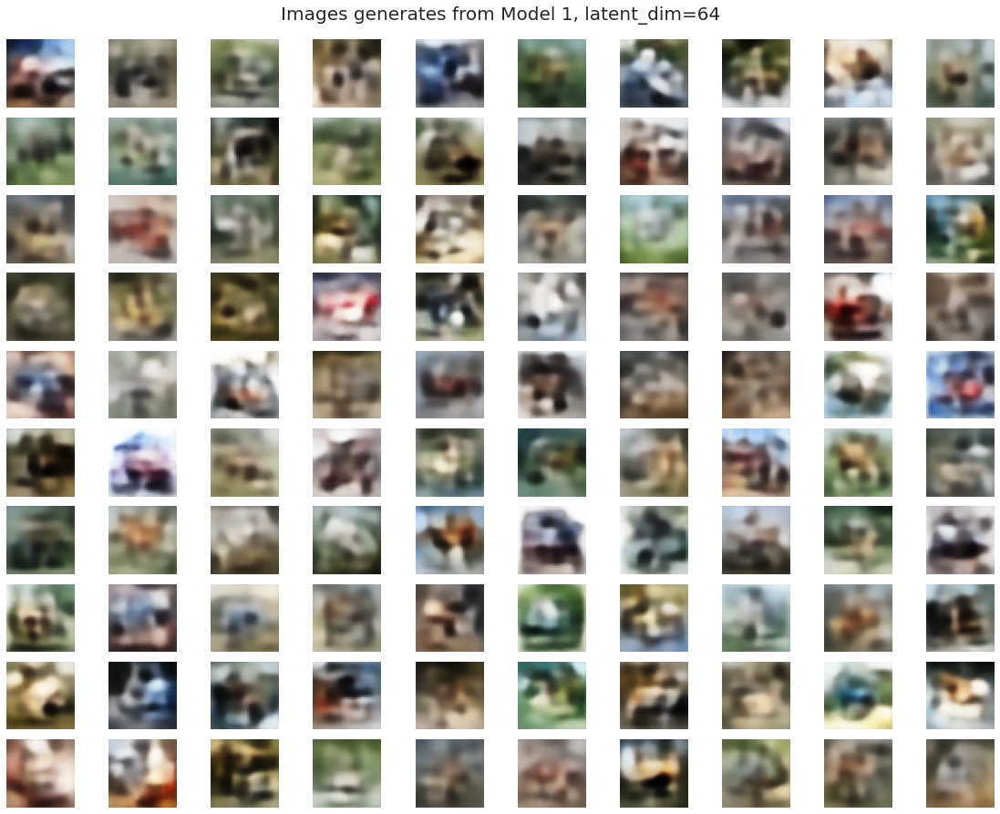

In [ ]:
plot_generate_images(prior=vae1.prior, decoder=vae1.decoder, title='Model 1, latent_dim=64')

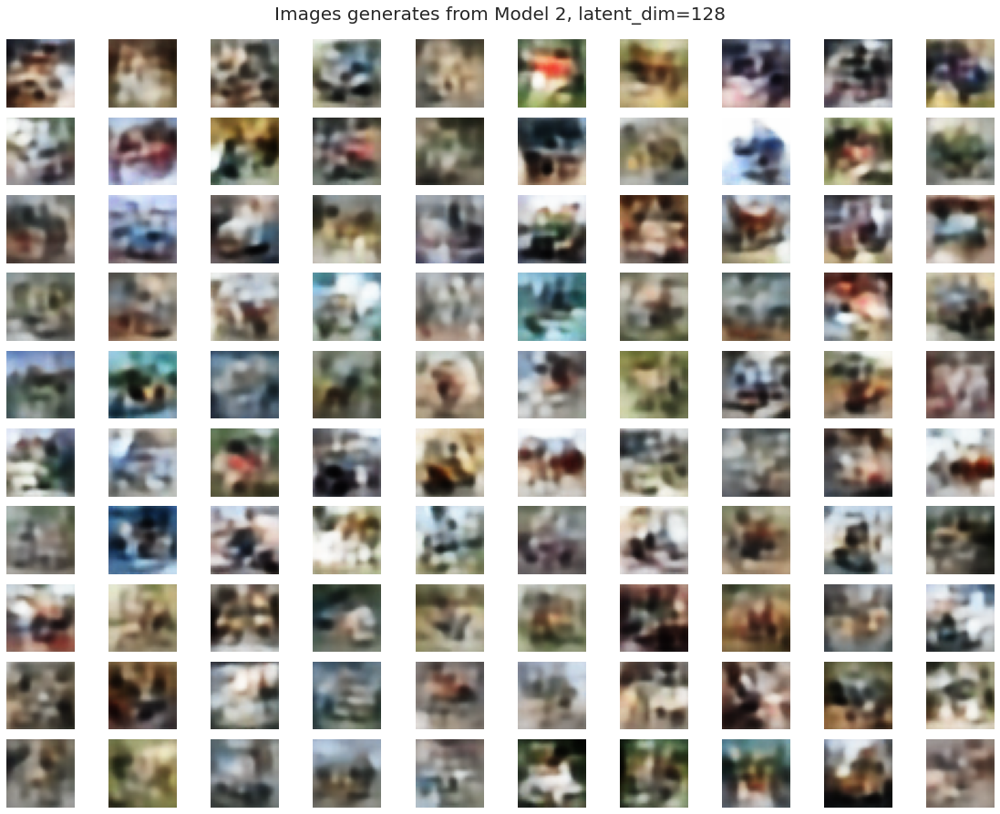

In [ ]:
plot_generate_images(prior=vae2.prior, decoder=vae2.decoder, title='Model 2, latent_dim=128')

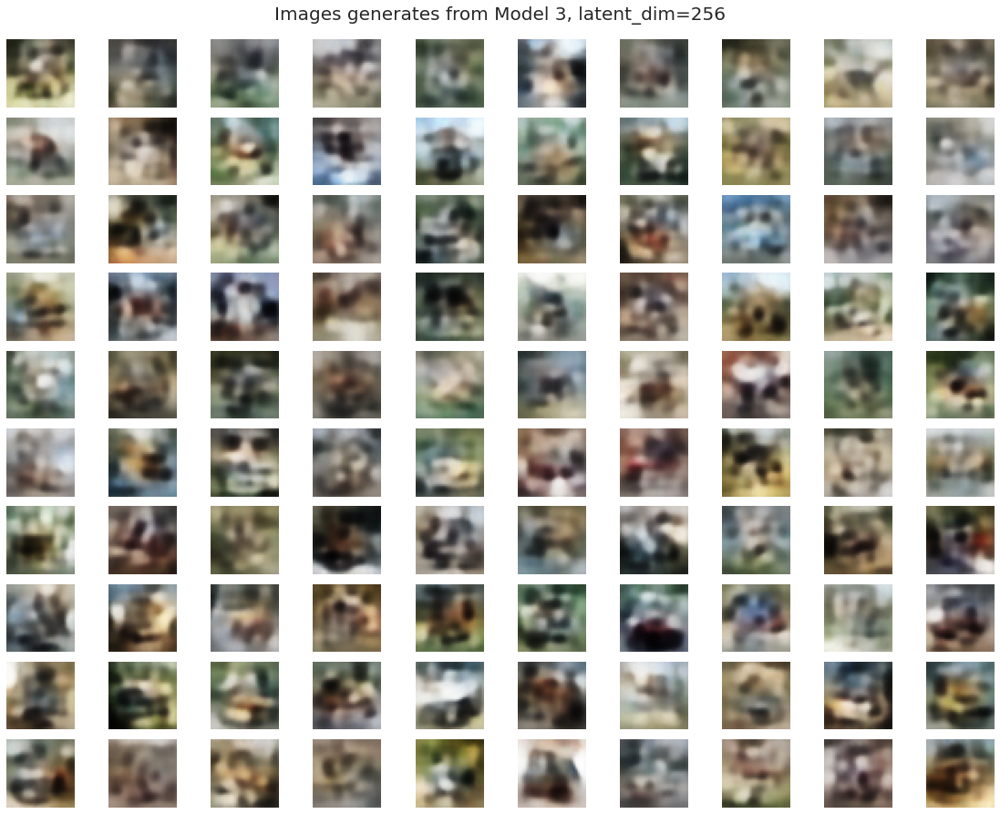

In [ ]:
plot_generate_images(prior=vae3.prior, decoder=vae3.decoder, title='Model 3, latent_dim=256')

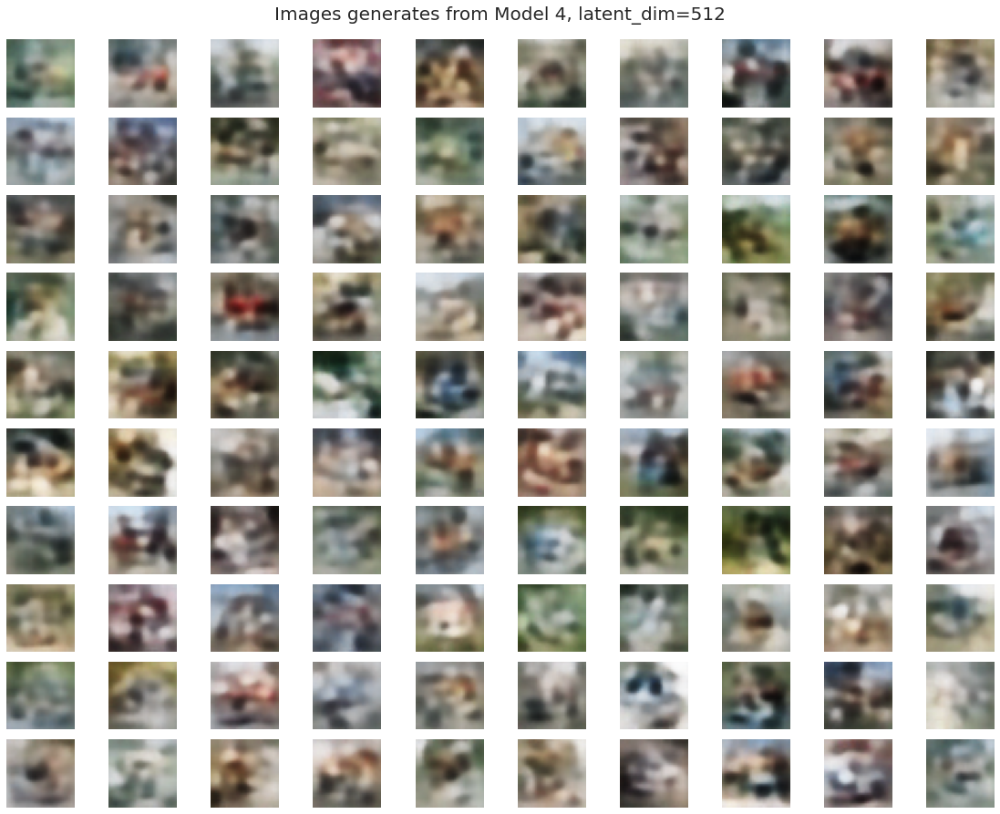

In [ ]:
plot_generate_images(prior=vae4.prior, decoder=vae4.decoder, title='Model 4, latent_dim=512')

### CelebA (subset) Dataset

In [ ]:
# Functions for loading and preprocessing the images

def load_image(filepath):
    raw_img = tf.io.read_file(filepath) 
    img_tensor_int = tf.image.decode_jpeg(raw_img, channels=3)
    img_tensor_flt = tf.image.convert_image_dtype(img_tensor_int, tf.float32)
    return img_tensor_flt, img_tensor_flt

def load_dataset(split):
    train_list_ds = tf.data.Dataset.list_files('{}/*.jpg'.format(split), shuffle=False)
    train_ds = train_list_ds.map(load_image)
    return train_ds

In [ ]:
train_dataset = load_dataset(path+'CelebA subset/train')
val_dataset = load_dataset(path+'CelebA subset/val')

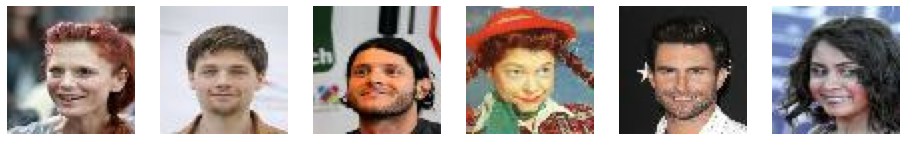

In [ ]:
# Display a few examples

n_examples_shown = 6
f, axs = plt.subplots(1, n_examples_shown, figsize=(16, 3))

for j, image in enumerate(train_dataset.take(n_examples_shown)):
  axs[j].imshow(image[0])
  axs[j].axis('off')

In [ ]:
# Batch the Dataset objects

batch_size = 32
train_dataset = train_dataset.batch(batch_size)
val_dataset = val_dataset.batch(batch_size)

In [ ]:
vae = CVAE3(latent_dim=256, shape=(64, 64, 3))

In [ ]:
history = compile_and_fit(model=vae, train_dataset=train_dataset, val_dataset=val_dataset, epochs=100, patience=4)

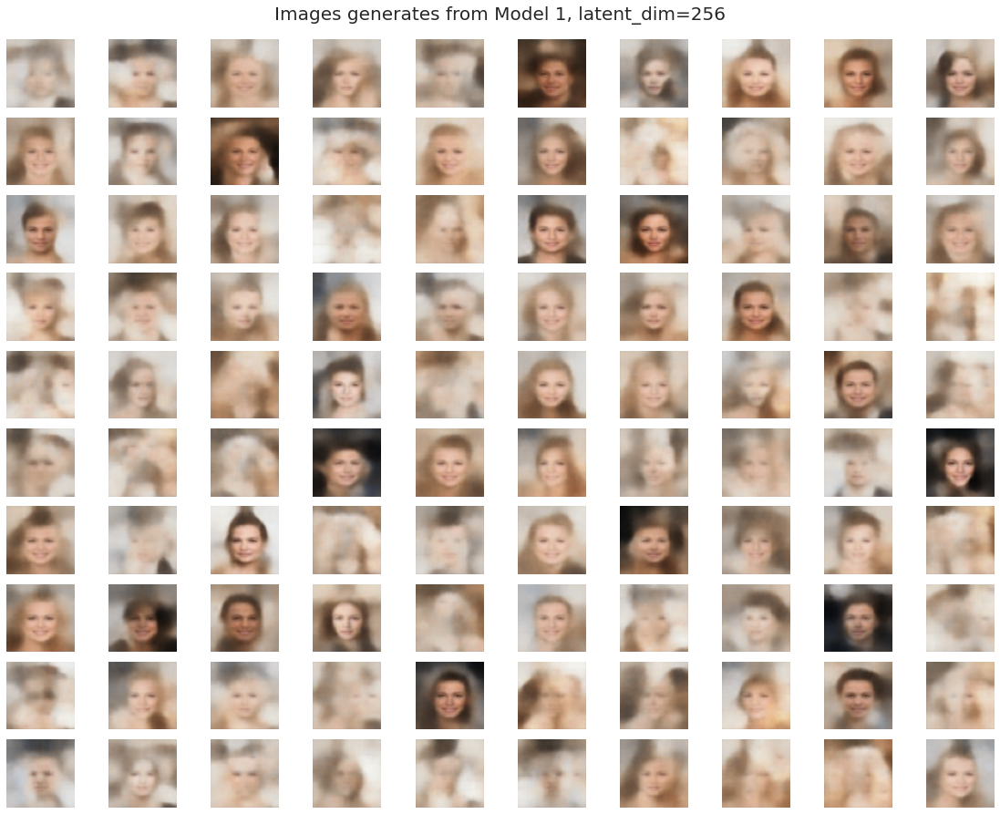

In [ ]:
plot_generate_images(prior=vae.prior, decoder=vae.decoder, title='Model 1, latent_dim=256')

## 2. Pronóstico de la velocidad del viento.

En esta sección trabajaremos con datos nacionales. El objetivo de este desafío es pronosticar la velocidad promedio a 20 metros de altura a diferentes instantes de tiempo.


<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/c/cd/Wind_turbines_in_southern_California_2016.jpg/660px-Wind_turbines_in_southern_California_2016.jpg" title="Title text" width="30%" />



El dataset contiene la velocidad media del viento a 20 metros de altura para cada instante de tiempo determinado. El conjunto de entrenamiento contiene 123365 registros cada 10 minutos de la velocidad media del viento desde el 19 de Diciembre de 2012 a las 00:10 hasta el 24 de Abril de 2015 a las 23:50.
El conjunto de set consta de 2000 registros a instantes de tiempos seleccionados entre el 26 de Abril y el 24 de Septiembre de 2015.

La efectividad del modelo se determinará comparando las predicciones para el conjunto de pruebas con los valores reales vía RMSE.

La competencia Kaggle es:

https://www.kaggle.com/c/prediccin-velocidad-del-viento/

Los datos para comenzar a trabajar se encuentran en dicha competencia, y también en:

http://www.inf.utfsm.cl/~cvalle/Winspeed.rar

Pueden también descargar los datos directamente a la máquina donde estén ejecutando el código con los siguientes comandos



 

### Librerias

In [1]:
# Librerias
import warnings; warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import seaborn as sns; sns.set_theme()
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dropout, Dense, GRU, LSTM
from tensorflow.keras.callbacks import EarlyStopping
from IPython.display import Image

pd.options.display.max_rows = 5000

### Conectar al drive

In [2]:
print("Mounting your Google Drive ...")

from google.colab import drive
drive.flush_and_unmount()
drive.mount('/content/drive', force_remount=True)

# Esta es la ruta en mi drive
path = '/content/drive/MyDrive/Intro a las redes neuronales/Tareas/Tarea 3/'

Mounting your Google Drive ...
Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


### Primer modelo

#### Carga de datos

In [ ]:
df = pd.read_csv(path + 'windspeed-training.csv', sep=',')
df.rename(columns={'Velocidad de viento en 20.0 metros [mean]': 'viento'}, inplace=True)

df_pred = pd.read_csv(path + 'windspeed-testing.csv', sep=',', header=None)
df_pred.rename(columns={0: 'Fecha'}, inplace=True)
df_pred.head()

,Fecha
0,26-04-2015 01:50
1,26-04-2015 03:10
2,26-04-2015 04:20
3,26-04-2015 05:20
4,26-04-2015 06:40


#### Preprocesamiento de los datos

In [ ]:
# Pseudo labeling

df_pseudo_7600 = pd.read_csv(path + 'pseudo_labeling_7600.csv', sep=',')
df_pseudo_7600 = df_pseudo_7600.iloc[:7600]
df_pseudo_10000 = pd.read_csv(path + 'pseudo_labeling_10000.csv', sep=',')
df_pseudo_10000 = df_pseudo_10000.iloc[1:10000]
df_pseudo_2000 = pd.read_csv(path + 'pseudo_labeling_2000.csv', sep=',')
df_pseudo_2000 = df_pseudo_2000.iloc[1:2000]
df_last_predictions = pd.read_csv(path + 'last_predictions.csv', sep=',')
df_last_predictions = df_last_predictions.iloc[1:]
df_last_predictions_2500 = pd.read_csv(path + 'last_predictions_2500.csv', sep=',')
df_last_predictions_2500 = df_last_predictions_2500.iloc[1:2500]
df_last_predictions_1500 = pd.read_csv(path + 'last_predictions_1500.csv', sep=',')
df_last_predictions_1500 = df_last_predictions_1500.iloc[1:1500]
df_ultimo = pd.read_csv(path + 'ultimas_predicciones.csv', sep=',')

In [ ]:
df = pd.concat([df, df_pseudo_7600, df_pseudo_10000, df_pseudo_2000, 
                df_last_predictions, df_last_predictions_2500,
                df_last_predictions_1500, df_ultimo], axis=0)

In [ ]:
df.head()

,Fecha,viento
0,2012-12-19 00:10,12.4
1,2012-12-19 00:20,11.4
2,2012-12-19 00:30,11.8
3,2012-12-19 00:40,11.6
4,2012-12-19 00:50,11.0


In [ ]:
df_test_pseudo = pd.DataFrame()
df_test_fechas = pd.DataFrame()

df_test_pseudo['viento'] = np.zeros(40000)

last_date = df.iloc[-1]['Fecha']
df_test_pseudo['Fecha'] = pd.date_range(last_date, periods=40000, freq='10T') # Last date prediction periods=21891 -> 2015-12-09 09:20:00
df_test_fechas['Fecha'] = pd.date_range(last_date, periods=40000, freq='10T') 

In [ ]:
df['Fecha'] = pd.to_datetime(df['Fecha'], format='%Y-%m-%d %H:%M')

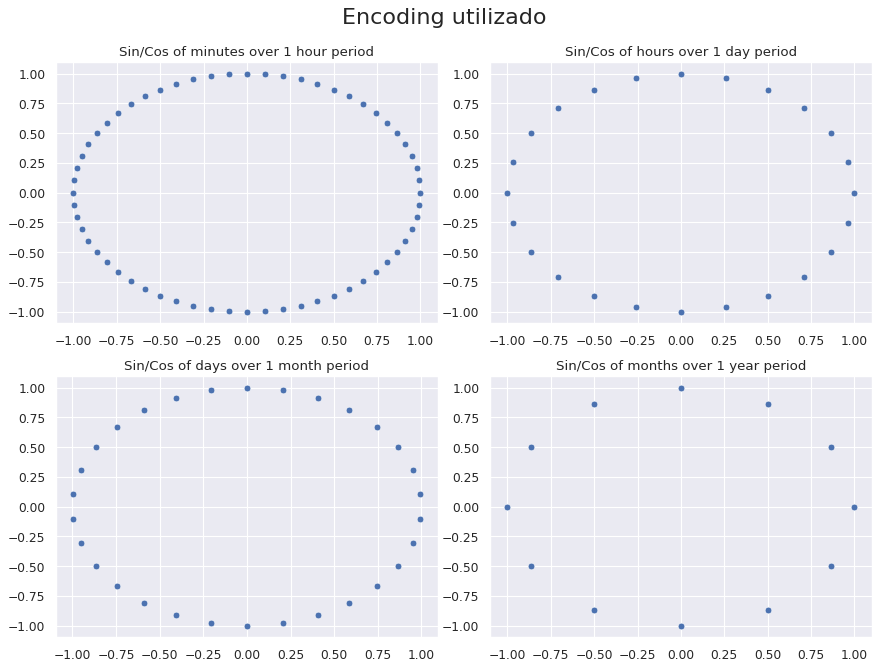

In [ ]:
minutes_in_day = 60
hours_in_day = 24
days_in_month = 30
month_in_year = 12

array_minutes = np.arange(60)
array_hours = np.arange(24)
array_days = np.arange(30)
array_months = np.arange(12)

array_minutes_sin = np.sin(2 * np.pi * array_minutes / minutes_in_day)
array_minutes_cos = np.cos(2 * np.pi * array_minutes / minutes_in_day)
array_hours_sin = np.sin(2 * np.pi * array_hours / hours_in_day)
array_hours_cos = np.cos(2 * np.pi * array_hours / hours_in_day)
array_days_sin = np.sin(2 * np.pi * array_days / days_in_month)
array_days_cos = np.cos(2 * np.pi * array_days / days_in_month)
array_months_sin = np.sin(2 * np.pi * array_months / month_in_year)
array_months_cos = np.cos(2 * np.pi * array_months / month_in_year)


fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 8), dpi=80)
fig.suptitle('Encoding utilizado', fontsize=20, y=1.04)

sns.scatterplot(x=array_minutes_sin, y=array_minutes_cos, ax=ax1)
ax1.set_title('Sin/Cos of minutes over 1 hour period')

sns.scatterplot(x=array_hours_sin, y=array_hours_cos, ax=ax2)
ax2.set_title('Sin/Cos of hours over 1 day period')

sns.scatterplot(x=array_days_sin, y=array_days_cos, ax=ax3)
ax3.set_title('Sin/Cos of days over 1 month period')

sns.scatterplot(x=array_months_sin, y=array_months_cos, ax=ax4)
ax4.set_title('Sin/Cos of months over 1 year period')

plt.tight_layout()
plt.show()

In [ ]:
# Positional encoding for training

timestamps = df['Fecha'].astype('str')

timestamps_min = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').minute) for t in timestamps])
timestamps_hour = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').hour) for t in timestamps])
timestamps_day = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').day) for t in timestamps])
timestamps_month = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').month) for t in timestamps])

df['sin_min'] = np.sin(2 * np.pi * timestamps_min / minutes_in_day)
df['cos_min'] = np.cos(2 * np.pi * timestamps_min / minutes_in_day)
df['sin_hour'] = np.sin(2 * np.pi * timestamps_hour / hours_in_day)
df['cos_hour'] = np.cos(2 * np.pi * timestamps_hour / hours_in_day)
df['sin_day'] = np.sin(2 * np.pi * timestamps_day / days_in_month)
df['cos_day'] = np.cos(2 * np.pi * timestamps_day / days_in_month)
df['sin_month'] = np.sin(2 * np.pi * timestamps_month / month_in_year)
df['cos_month'] = np.cos(2 * np.pi * timestamps_month / month_in_year)

df.drop(['Fecha'], axis = 1, inplace=True)

In [ ]:
# Positional encoding for testing

timestamps = df_test_pseudo['Fecha'].astype('str')

timestamps_min = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').minute) for t in timestamps])
timestamps_hour = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').hour) for t in timestamps])
timestamps_day = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').day) for t in timestamps])
timestamps_month = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').month) for t in timestamps])

df_test_pseudo['sin_min'] = np.sin(2 * np.pi * timestamps_min / minutes_in_day)
df_test_pseudo['cos_min'] = np.cos(2 * np.pi * timestamps_min / minutes_in_day)
df_test_pseudo['sin_hour'] = np.sin(2 * np.pi * timestamps_hour / hours_in_day)
df_test_pseudo['cos_hour'] = np.cos(2 * np.pi * timestamps_hour / hours_in_day)
df_test_pseudo['sin_day'] = np.sin(2 * np.pi * timestamps_day / days_in_month)
df_test_pseudo['cos_day'] = np.cos(2 * np.pi * timestamps_day / days_in_month)
df_test_pseudo['sin_month'] = np.sin(2 * np.pi * timestamps_month / month_in_year)
df_test_pseudo['cos_month'] = np.cos(2 * np.pi * timestamps_month / month_in_year)

df_test_pseudo.drop(['Fecha'], axis = 1, inplace=True)

In [ ]:
# Split in train and val
n = len(df)
df_train = df[0:int(n*0.9)]
df_val = df[int(n*0.9):]

In [ ]:
# Standarization
scaler = MinMaxScaler(feature_range=(-1, 1))
#scaler = RobustScaler()

df_train['viento'] = scaler.fit_transform(df_train['viento'].values.reshape(-1, 1))
df_val['viento'] = scaler.transform(df_val['viento'].values.reshape(-1, 1))

In [ ]:
def create_dataset(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        v = X.iloc[i:(i + time_steps)].values
        Xs.append(v)
        ys.append(y.iloc[i + time_steps])
    return np.array(Xs), np.array(ys)

In [ ]:
# reshape to [samples, time_steps, n_features]

X_train, y_train = create_dataset(X=df_train, y=df_train['viento'], time_steps=10)
X_val, y_val = create_dataset(X=df_val, y=df_val['viento'], time_steps=10)

print(X_train.shape, y_train.shape)

(111017, 10, 9) (111017,)


#### Modelo

In [ ]:
model = tf.keras.Sequential([
                             GRU(units=128, input_shape=(X_train.shape[1], X_train.shape[2])),
                             Dropout(rate=0.2),
                             Dense(units=1)
])

model.compile(optimizer=tf.keras.optimizers.Adam(),
              loss=tf.keras.losses.Huber(),
              metrics=[tf.keras.metrics.RootMeanSquaredError()])

In [ ]:
# early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True)

In [ ]:
history = model.fit(X_train, y_train, epochs=15, batch_size=32, validation_data=(X_val, y_val), callbacks=[early_stopping], shuffle=False)

Epoch 1/15
3470/3470 [==============================] - 21s 4ms/step - loss: 0.0057 - root_mean_squared_error: 0.1071 - val_loss: 0.0190 - val_root_mean_squared_error: 0.1948
Epoch 2/15
3470/3470 [==============================] - 13s 4ms/step - loss: 0.0038 - root_mean_squared_error: 0.0874 - val_loss: 0.0056 - val_root_mean_squared_error: 0.1059
Epoch 3/15
3470/3470 [==============================] - 13s 4ms/step - loss: 0.0036 - root_mean_squared_error: 0.0850 - val_loss: 0.0047 - val_root_mean_squared_error: 0.0966
Epoch 4/15
3470/3470 [==============================] - 14s 4ms/step - loss: 0.0035 - root_mean_squared_error: 0.0842 - val_loss: 0.0040 - val_root_mean_squared_error: 0.0893
Epoch 5/15
3470/3470 [==============================] - 13s 4ms/step - loss: 0.0035 - root_mean_squared_error: 0.0836 - val_loss: 0.0075 - val_root_mean_squared_error: 0.1223
Epoch 6/15
3470/3470 [==============================] - 12s 4ms/step - loss: 0.0035 - root_mean_squared_error: 0.0839 - val_l

#### Predicciones

In [ ]:
prediction = []
last_x = np.append(X_val[-1][1:], df_val.iloc[-1].values).reshape(10, 9)

for i in range(len(df_test_pseudo)):

  pred = model.predict(last_x[np.newaxis, ...])

  y_pred = pred[0][0]

  # Iterate
  output = np.append(y_pred, df_test_pseudo.iloc[i].values[1:])
  last_x = np.append(last_x[1:], output).reshape(10, 9)

  # Get prediction
  pred = scaler.inverse_transform(pred.reshape(-1, 1))[0][0]
  prediction.append(pred)

In [ ]:
df_test_fechas['viento'] = prediction

In [ ]:
df_test_fechas.to_csv('predicciones.csv', columns=['Fecha', 'viento'], index=False)

In [ ]:
df_pred['Fecha'] = pd.to_datetime(df_pred['Fecha'])

In [ ]:
valores = []
for i in range(2000):
  index = np.where(pd.to_datetime(df['Fecha']) == df_pred.iloc[i]['Fecha'])
  valores.append(df.iloc[index]['viento'].values[0])

In [ ]:
df_pred = pd.read_csv(path + 'windspeed-testing.csv', sep=',', header=None)
df_pred.rename(columns={0: 'Fecha'}, inplace=True)

df_pred['viento'] = valores
df_pred['viento'] = df_pred['viento'].astype('float')

df_pred.rename(columns={'Fecha': 'Fecha', 'viento': 'Velocidad de viento en 20.0 metros [mean]'}, inplace=True)

In [ ]:
df_pred.to_csv('predicciones.csv', columns=['Fecha', 'Velocidad de viento en 20.0 metros [mean]'], index=False)

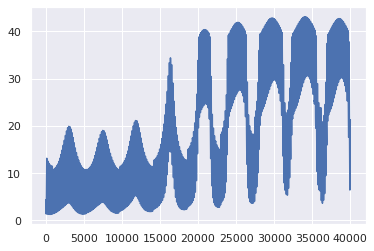

In [ ]:
Image(path+'predicciones.png', width=400)

### Segundo modelo

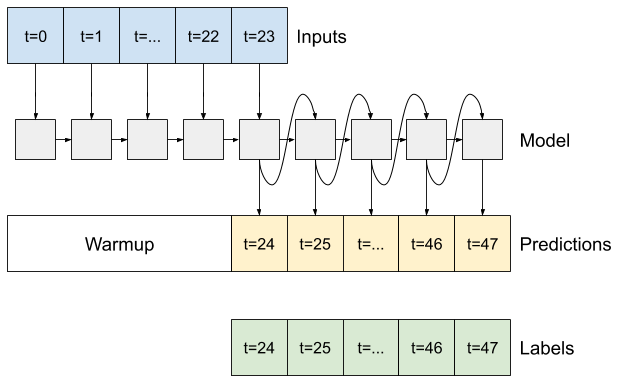

In [4]:
Image(path+'autoregressive.png', width=400)

#### Carga de datos

In [16]:
df = pd.read_csv(path + 'windspeed-training.csv', sep=',')
df.rename(columns={'Velocidad de viento en 20.0 metros [mean]': 'velocidad'}, inplace=True)

print('Shape df_train: ', df.shape)

df.head()

Shape df_train:  (123364, 2)


,Fecha,velocidad
0,2012-12-19 00:10,12.4
1,2012-12-19 00:20,11.4
2,2012-12-19 00:30,11.8
3,2012-12-19 00:40,11.6
4,2012-12-19 00:50,11.0


In [17]:
last_date = df.iloc[-1]['Fecha']
last_date

'2015-04-24 23:50'

In [18]:
df_test = pd.read_csv(path + 'windspeed-testing.csv', sep=',')

print('Shape df_test: ', df_test.shape)

df_test.head()

Shape df_test:  (1999, 1)


,26-04-2015 01:50
0,26-04-2015 03:10
1,26-04-2015 04:20
2,26-04-2015 05:20
3,26-04-2015 06:40
4,26-04-2015 10:30


#### Preprocesamiento de los datos

In [6]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
velocidad,123364.0,7.705984,4.444693,0.0,3.9,7.7,11.1,25.5


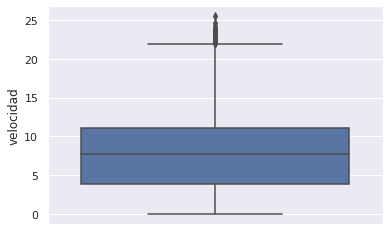

In [7]:
sns.boxplot(y=df['velocidad'])
plt.show()

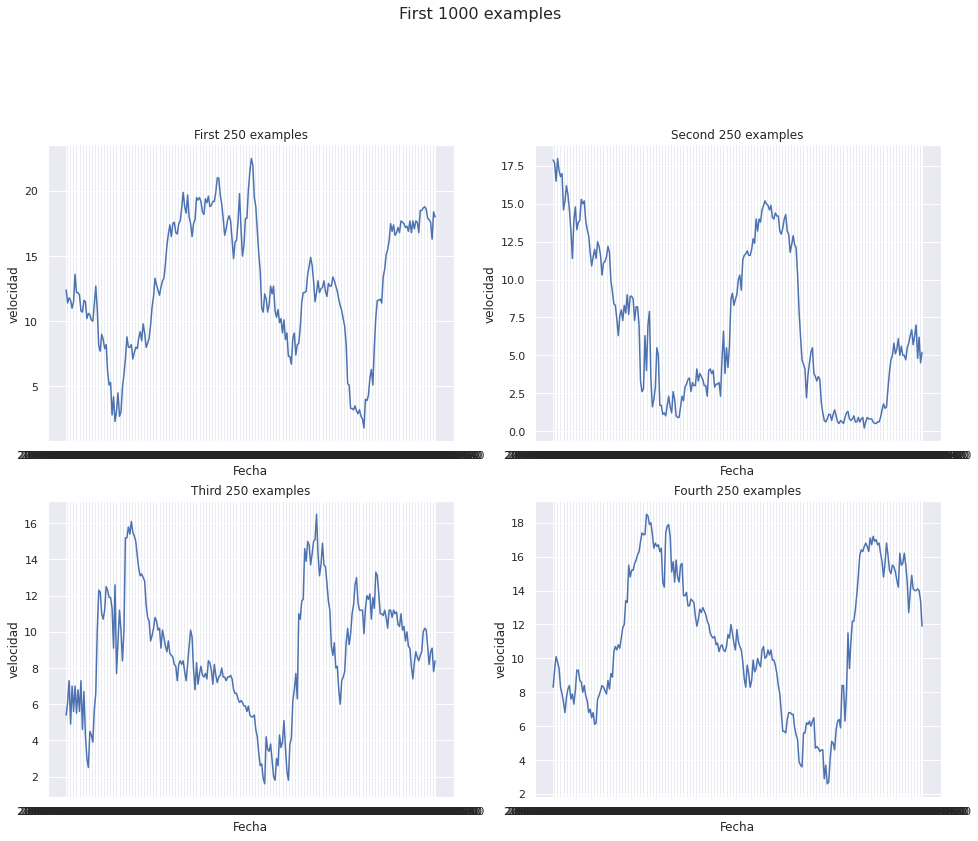

In [8]:
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
fig.suptitle('First 1000 examples', fontsize=16, y=1.04)
ax = axes.flatten()

sns.lineplot(x=df[:250]['Fecha'], y=df[:250]['velocidad'], ax=ax[0]).set_title("First 250 examples")
sns.lineplot(x=df[250:500]['Fecha'], y=df[250:500]['velocidad'], ax=ax[1]).set_title("Second 250 examples")
sns.lineplot(x=df[500:750]['Fecha'], y=df[500:750]['velocidad'], ax=ax[2]).set_title("Third 250 examples")
sns.lineplot(x=df[750:1000]['Fecha'], y=df[750:1000]['velocidad'], ax=ax[3]).set_title("Fourth 250 examples")
plt.show()

In [19]:
timestamps = [ts.split('+')[0] for ts in  df['Fecha']]

timestamps_min = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').minute) for t in timestamps])
timestamps_hour = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').hour) for t in timestamps])
timestamps_day = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').day) for t in timestamps])
timestamps_month = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M').month) for t in timestamps])

In [20]:
minutes_in_day = 60
hours_in_day = 24
days_in_month = 30
month_in_year = 12

df['sin_min'] = np.sin(2 * np.pi * timestamps_min / minutes_in_day)
df['cos_min'] = np.cos(2 * np.pi * timestamps_min / minutes_in_day)
df['sin_hour'] = np.sin(2 * np.pi * timestamps_hour / hours_in_day)
df['cos_hour'] = np.cos(2 * np.pi * timestamps_hour / hours_in_day)
df['sin_day'] = np.sin(2 * np.pi * timestamps_day / days_in_month)
df['cos_day'] = np.cos(2 * np.pi * timestamps_day / days_in_month)
df['sin_month'] = np.sin(2 * np.pi * timestamps_month / month_in_year)
df['cos_month'] = np.cos(2 * np.pi * timestamps_month / month_in_year)

In [21]:
df.drop(['Fecha'], axis = 1, inplace=True)
df.head()

,velocidad,sin_min,cos_min,sin_hour,cos_hour,sin_day,cos_day,sin_month,cos_month
0,12.4,8.660254e-01,0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
1,11.4,8.660254e-01,-0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
2,11.8,5.665539e-16,-1.0,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
3,11.6,-8.660254e-01,-0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
4,11.0,-8.660254e-01,0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0


In [22]:
array_minutes = np.arange(60)
array_hours = np.arange(24)
array_days = np.arange(30)
array_months = np.arange(12)

array_minutes_sin = np.sin(2 * np.pi * array_minutes / minutes_in_day)
array_minutes_cos = np.cos(2 * np.pi * array_minutes / minutes_in_day)
array_hours_sin = np.sin(2 * np.pi * array_hours / hours_in_day)
array_hours_cos = np.cos(2 * np.pi * array_hours / hours_in_day)
array_days_sin = np.sin(2 * np.pi * array_days / days_in_month)
array_days_cos = np.cos(2 * np.pi * array_days / days_in_month)
array_months_sin = np.sin(2 * np.pi * array_months / month_in_year)
array_months_cos = np.cos(2 * np.pi * array_months / month_in_year)

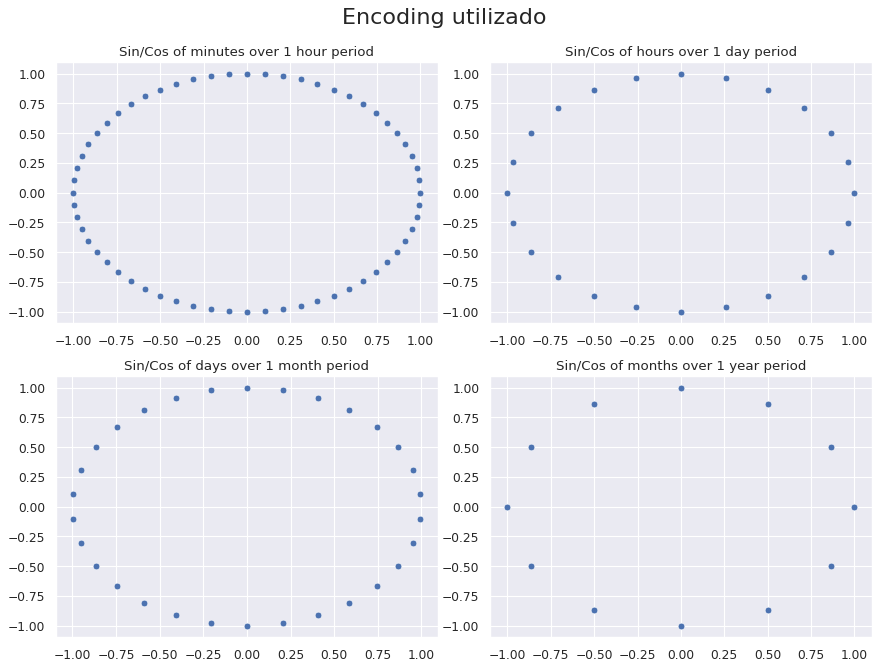

In [23]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 8), dpi=80)
fig.suptitle('Encoding utilizado', fontsize=20, y=1.04)

sns.scatterplot(x=array_minutes_sin, y=array_minutes_cos, ax=ax1)
ax1.set_title('Sin/Cos of minutes over 1 hour period')

sns.scatterplot(x=array_hours_sin, y=array_hours_cos, ax=ax2)
ax2.set_title('Sin/Cos of hours over 1 day period')

sns.scatterplot(x=array_days_sin, y=array_days_cos, ax=ax3)
ax3.set_title('Sin/Cos of days over 1 month period')

sns.scatterplot(x=array_months_sin, y=array_months_cos, ax=ax4)
ax4.set_title('Sin/Cos of months over 1 year period')

plt.tight_layout()
plt.show()

In [24]:
# Split in train and val
n = len(df)
df_train = df[0:int(n*0.9)]
df_val = df[int(n*0.9):]

num_features = df.shape[1]

In [25]:
# Standarization
scaler = MinMaxScaler(feature_range=(-1, 1))
#scaler = RobustScaler()

df_train['velocidad'] = scaler.fit_transform(df_train['velocidad'].values.reshape(-1, 1))
df_val['velocidad'] = scaler.transform(df_val['velocidad'].values.reshape(-1, 1))

In [26]:
df_train.head()

,velocidad,sin_min,cos_min,sin_hour,cos_hour,sin_day,cos_day,sin_month,cos_month
0,-0.027451,8.660254e-01,0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
1,-0.105882,8.660254e-01,-0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
2,-0.074510,5.665539e-16,-1.0,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
3,-0.090196,-8.660254e-01,-0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0
4,-0.137255,-8.660254e-01,0.5,0.0,1.0,-0.743145,-0.669131,-2.449294e-16,1.0


In [27]:
pd.DataFrame(df_train['velocidad'].describe()).transpose()

,count,mean,std,min,25%,50%,75%,max
velocidad,111027.0,-0.385594,0.349262,-1.0,-0.678431,-0.380392,-0.121569,1.0


In [28]:
df_val.head()

,velocidad,sin_min,cos_min,sin_hour,cos_hour,sin_day,cos_day,sin_month,cos_month
111027,-0.874510,-8.660254e-01,0.5,0.965926,-0.258819,-0.207912,0.978148,0.5,0.866025
111028,-0.858824,0.000000e+00,1.0,0.866025,-0.500000,-0.207912,0.978148,0.5,0.866025
111029,-0.835294,8.660254e-01,0.5,0.866025,-0.500000,-0.207912,0.978148,0.5,0.866025
111030,-0.803922,8.660254e-01,-0.5,0.866025,-0.500000,-0.207912,0.978148,0.5,0.866025
111031,-0.780392,5.665539e-16,-1.0,0.866025,-0.500000,-0.207912,0.978148,0.5,0.866025


In [29]:
pd.DataFrame(df_val['velocidad'].describe()).transpose()

,count,mean,std,min,25%,50%,75%,max
velocidad,12337.0,-0.485741,0.329192,-1.0,-0.780392,-0.521569,-0.231373,0.529412


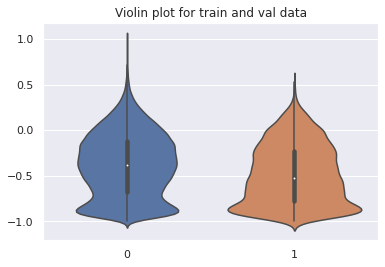

In [30]:
sns.violinplot(data=[df_train['velocidad'], df_val['velocidad']]).set_title('Violin plot for train and val data')
plt.show()

#### Modelo

In [31]:
# WindowGenerator from https://www.tensorflow.org/tutorials/structured_data/time_series

class WindowGenerator():

  def __init__(self, input_width, label_width, shift, df_train=df_train, df_val=df_val, label_columns=None):

    # Store the raw data.
    self.df_train = df_train
    self.df_val = df_val
    
    # Work out the label column indices.
    self.label_columns = label_columns

    if label_columns is not None:

      self.label_columns_indices = {name: i for i, name in enumerate(label_columns)}

    self.column_indices = {name: i for i, name in enumerate(df_train.columns)}

    # Work out the window parameters.
    self.input_width = input_width
    self.label_width = label_width
    self.shift = shift

    self.total_window_size = input_width + shift

    self.input_slice = slice(0, input_width)
    self.input_indices = np.arange(self.total_window_size)[self.input_slice]

    self.label_start = self.total_window_size - self.label_width
    self.labels_slice = slice(self.label_start, None)
    self.label_indices = np.arange(self.total_window_size)[self.labels_slice]

  def __repr__(self):
    return '\n'.join([
        f'Total window size: {self.total_window_size}',
        f'Input indices: {self.input_indices}',
        f'Label indices: {self.label_indices}',
        f'Label column name(s): {self.label_columns}'])

In [32]:
# https://www.tensorflow.org/tutorials/structured_data/time_series

def split_window(self, features):
  inputs = features[:, self.input_slice, :]
  labels = features[:, self.labels_slice, :]
  if self.label_columns is not None:
    labels = tf.stack(
        [labels[:, :, self.column_indices[name]] for name in self.label_columns], axis=-1)

  # Slicing doesn't preserve static shape information, so set the shapes
  # manually. This way the `tf.data.Datasets` are easier to inspect.
  inputs.set_shape([None, self.input_width, None])
  labels.set_shape([None, self.label_width, None])

  return inputs, labels

WindowGenerator.split_window = split_window

def make_dataset(self, data):
  data = np.array(data, dtype=np.float32)
  ds = tf.keras.preprocessing.timeseries_dataset_from_array(
      data=data,
      targets=None,
      sequence_length=self.total_window_size,
      sequence_stride=1,
      shuffle=False, # shuffle = True
      batch_size=32,)

  ds = ds.map(self.split_window)

  return ds

WindowGenerator.make_dataset = make_dataset

@property
def train(self):
  return self.make_dataset(self.df_train)

@property
def val(self):
  return self.make_dataset(self.df_val)

WindowGenerator.train = train
WindowGenerator.val = val

In [33]:
OUT_STEPS = 144
w1 = WindowGenerator(input_width=144, label_width=OUT_STEPS, shift=OUT_STEPS, label_columns=['velocidad'])
w1

Total window size: 288
Input indices: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143]
Label indices: [144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 2

In [34]:
for example_inputs, example_labels in w1.train.take(1):
  
  print(f'Inputs shape (batch, time, features): {example_inputs.shape}')
  print(f'Labels shape (batch, time, features): {example_labels.shape}')

Inputs shape (batch, time, features): (32, 144, 9)
Labels shape (batch, time, features): (32, 144, 1)


In [35]:
class FeedBack(tf.keras.Model):

  def __init__(self, units, out_steps):
    
    super().__init__()
    self.out_steps = out_steps
    self.units = units
    self.lstm_cell = tf.keras.layers.LSTMCell(units)
    # Also wrap the LSTMCell in an RNN to simplify the `warmup` method.
    self.lstm_rnn = tf.keras.layers.RNN(self.lstm_cell, return_state=True)
    self.dense = tf.keras.layers.Dense(num_features)

feedback_model = FeedBack(units=32, out_steps=OUT_STEPS)

In [36]:
def warmup(self, inputs):
  # inputs.shape => (batch, time, features)
  # x.shape => (batch, lstm_units)
  x, *state = self.lstm_rnn(inputs)

  # predictions.shape => (batch, features)
  prediction = self.dense(x)
  return prediction, state

FeedBack.warmup = warmup

In [37]:
def call(self, inputs, training=None):
  # Use a TensorArray to capture dynamically unrolled outputs.
  predictions = []
  # Initialize the lstm state
  prediction, state = self.warmup(inputs)

  # Insert the first prediction
  predictions.append(prediction)

  # Run the rest of the prediction steps
  for n in range(1, self.out_steps):
    # Use the last prediction as input.
    x = prediction
    # Execute one lstm step.
    x, state = self.lstm_cell(x, states=state,
                              training=training)
    # Convert the lstm output to a prediction.
    prediction = self.dense(x)
    # Add the prediction to the output
    predictions.append(prediction)

  # predictions.shape => (time, batch, features)
  predictions = tf.stack(predictions)
  # predictions.shape => (batch, time, features)
  predictions = tf.transpose(predictions, [1, 0, 2])
  return predictions

FeedBack.call = call

In [38]:
feedback_model.compile(optimizer=tf.keras.optimizers.Adam(),
              loss=tf.keras.losses.Huber(),
              metrics=[tf.keras.metrics.RootMeanSquaredError()])

In [39]:
# Callbacks for the model

# early stopping
early_stopping = EarlyStopping(monitor='val_root_mean_squared_error', patience=4, restore_best_weights=True)

In [ ]:
MAX_EPOCHS = 50

history = feedback_model.fit(w1.train, validation_data=w1.val, epochs=MAX_EPOCHS, callbacks=[early_stopping], shuffle=False)

## Predicciones

In [35]:
df_test_encoding = pd.DataFrame()
df_test_fechas = pd.DataFrame()

df_test_encoding['viento'] = np.zeros(40000)

df_test_encoding['Fecha'] = pd.date_range(last_date, periods=40000, freq='10T') # Last date prediction periods=21891 -> 2015-12-09 09:20:00
df_test_fechas['Fecha'] = pd.date_range(last_date, periods=40000, freq='10T') 

In [38]:
# Positional encoding for testing

timestamps = df_test_encoding['Fecha'].astype('str')

timestamps_min = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').minute) for t in timestamps])
timestamps_hour = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').hour) for t in timestamps])
timestamps_day = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').day) for t in timestamps])
timestamps_month = np.array([float(datetime.datetime.strptime(t, '%Y-%m-%d %H:%M:%S').month) for t in timestamps])

df_test_encoding['sin_min'] = np.sin(2 * np.pi * timestamps_min / minutes_in_day)
df_test_encoding['cos_min'] = np.cos(2 * np.pi * timestamps_min / minutes_in_day)
df_test_encoding['sin_hour'] = np.sin(2 * np.pi * timestamps_hour / hours_in_day)
df_test_encoding['cos_hour'] = np.cos(2 * np.pi * timestamps_hour / hours_in_day)
df_test_encoding['sin_day'] = np.sin(2 * np.pi * timestamps_day / days_in_month)
df_test_encoding['cos_day'] = np.cos(2 * np.pi * timestamps_day / days_in_month)
df_test_encoding['sin_month'] = np.sin(2 * np.pi * timestamps_month / month_in_year)
df_test_encoding['cos_month'] = np.cos(2 * np.pi * timestamps_month / month_in_year)

df_test_encoding.drop(['Fecha'], axis = 1, inplace=True)

In [56]:
# Get predictions

times_step = 144

predictions = []
predicciones = feedback_model(tf.expand_dims(df_val.iloc[-times_step:], axis=0))
batch_predicciones = [predicciones[0][i][0] for i in range(times_step)]
predictions.append(batch_predicciones)
index_fechas = 0
predicciones = []
for pred in batch_predicciones:
  predicciones.append(np.append(pred, df_test_encoding.iloc[index_fechas].values[1:]))
  index_fechas+=1

for i in range(500):
  predicciones = feedback_model.predict(tf.expand_dims(np.array(predicciones), axis=0))
  batch_predicciones = [predicciones[0][i][0] for i in range(times_step)]
  predictions.append(batch_predicciones)
  predicciones = []
  for pred in batch_predicciones:
    predicciones.append(np.append(pred, df_test_encoding.iloc[index_fechas].values[1:]))
    index_fechas+=1

In [57]:
pred = np.array(predictions).reshape(-1)
pred_normal = scaler.inverse_transform(pred.reshape(-1, 1))

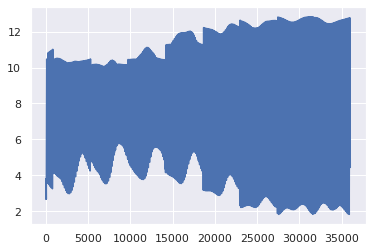

In [59]:
sns.lineplot(x=range(len(pred_normal)), y=pred_normal.reshape(-1))

In [60]:
df_pred = pd.read_csv(path + 'windspeed-testing.csv', sep=',', header=None)
df_pred.rename(columns={0: 'Fecha'}, inplace=True)
df_pred['Fecha'] = pd.to_datetime(df_pred['Fecha'], dayfirst=True)
df_pred.head()

,Fecha
0,2015-04-26 01:50:00
1,2015-04-26 03:10:00
2,2015-04-26 04:20:00
3,2015-04-26 05:20:00
4,2015-04-26 06:40:00


In [61]:
df_test_fechas = df_test_fechas.iloc[:len(pred_normal)] 

In [62]:
df_test_fechas['viento'] = pred_normal

In [63]:
valores = []
for i in range(2000):
  index = np.where(pd.to_datetime(df_test_fechas['Fecha']) == df_pred.iloc[i]['Fecha'])
  valores.append(df_test_fechas.iloc[index]['viento'].values[0])

In [64]:
df_pred = pd.read_csv(path + 'windspeed-testing.csv', sep=',', header=None)
df_pred.rename(columns={0: 'Fecha'}, inplace=True)

df_pred['viento'] = valores
df_pred['viento'] = df_pred['viento'].astype('float')

df_pred.rename(columns={'Fecha': 'Fecha', 'viento': 'Velocidad de viento en 20.0 metros [mean]'}, inplace=True)

In [65]:
df_pred.head()

,Fecha,Velocidad de viento en 20.0 metros [mean]
0,26-04-2015 01:50,5.860646
1,26-04-2015 03:10,5.101508
2,26-04-2015 04:20,4.601261
3,26-04-2015 05:20,4.753213
4,26-04-2015 06:40,4.249253


In [66]:
df_pred.to_csv('predicciones.csv', columns=['Fecha', 'Velocidad de viento en 20.0 metros [mean]'], index=False)